# Project Description: Coin Recognition Using Deep Learning
## Overview

In this project, I explored the efficacy of three object detection deep learning models; VGG16, ResNet50 and YOLOv5. The objective was to develop an intelligent coin recognition system capable of identifying denominations of Israeli Shekel coins (1, 2, 5, 10 ILS) within images. By leveraging the power of deep learning, particularly convolutional neural networks (CNNs), the system is trained to accurately classify coins based on labeled data with bounding boxes indicating the location and value of each coin.

This will be performed in three parts:
1. Introduction and technical details
2. code
3. Comprehensive comparison of the performance of the three models for the coin recognition task. This comparison will consider factors like accuracy, speed, and computational efficiency to determine the most suitable model for real-world applications.

## Key Features
* Data Annotation and Extraction: A custom function parses JSON files containing annotations for coin images. These annotations include bounding boxes and labels for each coin, which are then combined with the corresponding image paths.
* Image Preprocessing: Functionality is included to load and preprocess images by extracting regions of interest (ROIs) based on bounding box coordinates, resizing them to the required input dimensions for the neural network, and normalizing pixel values.
* Deep Learning Models: The project investigates multiple deep learning models for coin recognition, including:
 * VGG16: A well-established pre-trained CNN architecture that will be fine-tuned for coin classification.
 * ResNet50: Another powerful CNN architecture known for its depth and performance, also fine-tuned for coin recognition.
 * YOLOv5: A state-of-the-art real-time object detection model trained to identify and localize coins within images.
* Training with Early Stopping: All models incorporate early stopping to prevent overfitting. This technique halts the training process if the validation accuracy doesn't improve after a specified number of epochs (for VGG16 or ResNet50), or based on the metrics uses the weights of the best epoch (for Yolov5).
* Model Evaluation and Visualization: Model performance is evaluated on a validation set, and training history is visualized to track accuracy and loss over epochs. The models' accuracy on the test set is also reported.

Technical Details
* Libraries and Tools: TensorFlow, Keras, OpenCV, NumPy, Pandas, Matplotlib, Scikit-learn and PyTorch.
* Data Handling: Custom functions for annotation extraction and image preprocessing (for VGG16 and ResNet50).
* Model Architectures:
 * VGG16 and ResNet50: Base models pre-trained (freezed) on ImageNet, fine-tuned with additional layers for multi-class coin classification.
 * YOLOv5: A single model specifically designed for object detection and localization.
* Training Strategy: Early stopping based on validation accuracy for all models.

# Code Implementation

1. Data Processing: extracting annotations from a JSON file and combining them with image paths.
2. Image Preprocessing: loading and preprocessing images, including cropping and resizing.
3. Model Building: creating and fine-tuning VGG16, ResNet50, and YOLOv5 models for coin recognition.
4. Model Training: training the models on the preprocessed images and their labels.
5. Evaluation and Visualization: plotting training accuracy over epochs and evaluating the models on the test set.
6. Model Saving: saving the trained models to files.

# 2a+b: VGG16 and Resnet50

In [1]:
# connect to drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import os
import numpy as np
import pandas as pd
import tensorflow as tf
import cv2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from sklearn.model_selection import train_test_split
import json
import matplotlib.pyplot as plt
from tensorflow.keras.applications import VGG16
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping # Import EarlyStopping
import time

## VGG16

In [34]:
# extracting labels from the json file
def extract_annotations_from_json(label_path):
    data = []
    with open(label_path, 'r') as f:
        label_data = json.load(f)

    for item in label_data:
        annotations = item.get("annotations", [])
        image_name = item.get("data", [])
        for annotation in annotations:
            if image_name:
                for i in range(len(annotation['result'])):
                    original_width = annotation["result"][i]["original_width"]
                    original_height = annotation["result"][i]["original_height"]
                    labels = annotation['result'][i]['value']['rectanglelabels']
                    x = annotation['result'][i]['value']['x'] / 100.0
                    y = annotation['result'][i]['value']['y'] / 100.0
                    width = annotation['result'][i]['value']['width'] / 100.0
                    height = annotation['result'][i]['value']['height'] / 100.0
                    data.append({"image_name": image_name['image'].split('1/')[-1], "original_width": original_width,
                                 "original_height": original_height, "labels": labels, "x": x, "y": y, "width": width, "height": height})

    df = pd.DataFrame(data)
    return df

def combine_with_image_paths(df, image_path):
    df["image_path"] = image_path + df['image_name']
    return df

def load_and_preprocess_image(image_path, bbox):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h, w, _ = img.shape
    x = int(bbox['x'] * w)
    y = int(bbox['y'] * h)
    width = int(bbox['width'] * w)
    height = int(bbox['height'] * h)

    # Ensure the coordinates are within the image dimensions
    x = max(0, x)
    y = max(0, y)
    width = min(w - x, width)
    height = min(h - y, height)

    cropped_img = img[y:y + height, x:x + width]
    if cropped_img.size == 0:
        return None

    resized_img = cv2.resize(cropped_img, (224, 224))
    return resized_img / 255.0


if __name__ == "__main__":
    # Define paths and load images
    image_path = "/content/drive/MyDrive/project_2_coins_labeled/1/"
    label_path = "/content/drive/MyDrive/project_2_coins_labeled/project_2_labels.json"
    new_image_path = "/content/drive/MyDrive/project_2_coins_labeled/test/Image.jpeg"

    annotations_df = extract_annotations_from_json(label_path)

    if image_path:
        annotations_df = combine_with_image_paths(annotations_df.copy(), image_path)

    annotations_df["labels"] = annotations_df["labels"].str[-1]

    label_map = {
        '1 Shekel Coin': 0,
        '2 Shekel Coin': 1,
        '5 Shekel Coin': 2,
        '10 Shekel Coin': 3
    }
    annotations_df['label_id'] = annotations_df['labels'].map(label_map)

    images, labels = annotations_df["image_path"], annotations_df["label_id"]
    X = []
    y = []

    for i, img_path in enumerate(images):
        bbox = annotations_df.iloc[i][['x', 'y', 'width', 'height']]
        img = load_and_preprocess_image(img_path, bbox)
        if img is not None:
            X.append(img)
            y.append(labels.iloc[i])

    X = np.array(X)
    y = np.array(y)



58889256/58889256 [==============================] - 2s 0us/step
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 25088)             0         
                                                                 
 dense (Dense)               (None, 512)               12845568  
                                                                 
 dense_1 (Dense)             (None, 128)               65664     
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_2 (Dense)             (None, 64)                8256      
                                                         

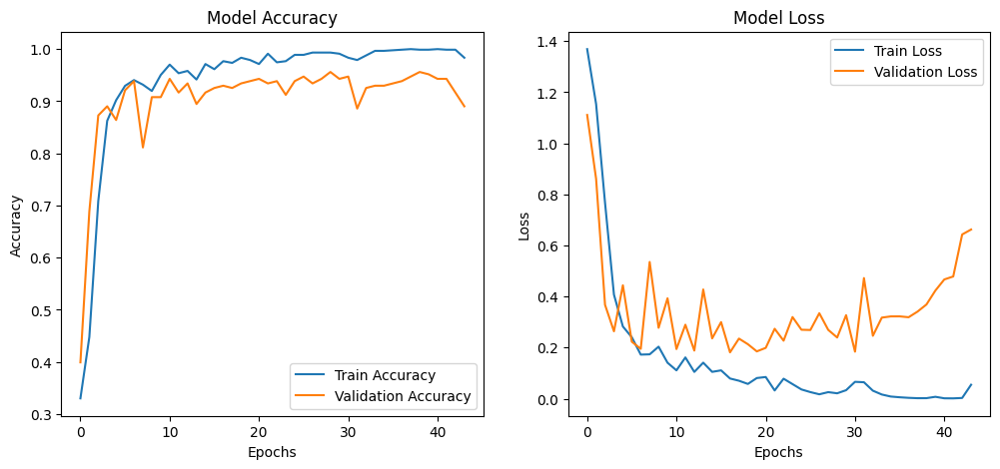

8/8 - 1s - loss: 0.2397 - accuracy: 0.9561 - 1s/epoch - 128ms/step
Test accuracy: 0.9561403393745422


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
start_time_VGG = time.time()

def create_model(num_classes):
    base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    model = Sequential([
        base_model,
        Flatten(),
        Dense(512, activation='relu'),
        Dense(128, activation='relu'),
        Dropout(0.5),
        Dense(64, activation='relu'),
        Dense(num_classes, activation='softmax')  # Multi-class classification
    ])
    model.compile(optimizer=Adam(learning_rate=1e-4), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model


# split, and train model
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = create_model(num_classes=4)
model.summary()

early_stopping = EarlyStopping(monitor='val_accuracy', patience=15, restore_best_weights=True)

history = model.fit(X_train, y_train, epochs=50, validation_data=(X_test, y_test), batch_size=32, callbacks=[early_stopping])

end_time_VGG = time.time()

# Plot training and validation loss/accuracy curves
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Model Accuracy')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Model Loss')

plt.show()

test_loss, test_acc = model.evaluate(X_test, y_test, verbose=2)
print(f"Test accuracy: {test_acc}")

model.save('coin_recognition_model_VGG16.h5')


1/1 [==============================] - 0s 34ms/step


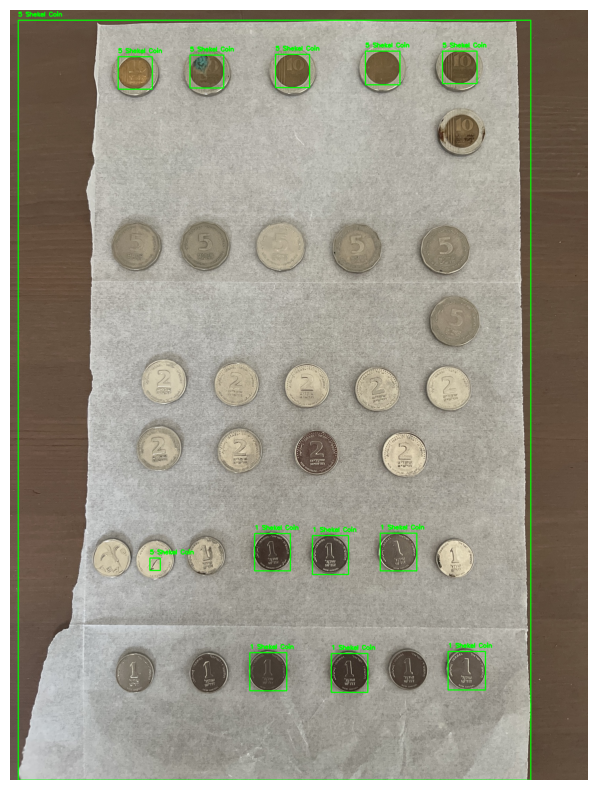

Total amount: 41 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[6 0]
 [0 7]]
1/1 [==============================] - 0s 25ms/step


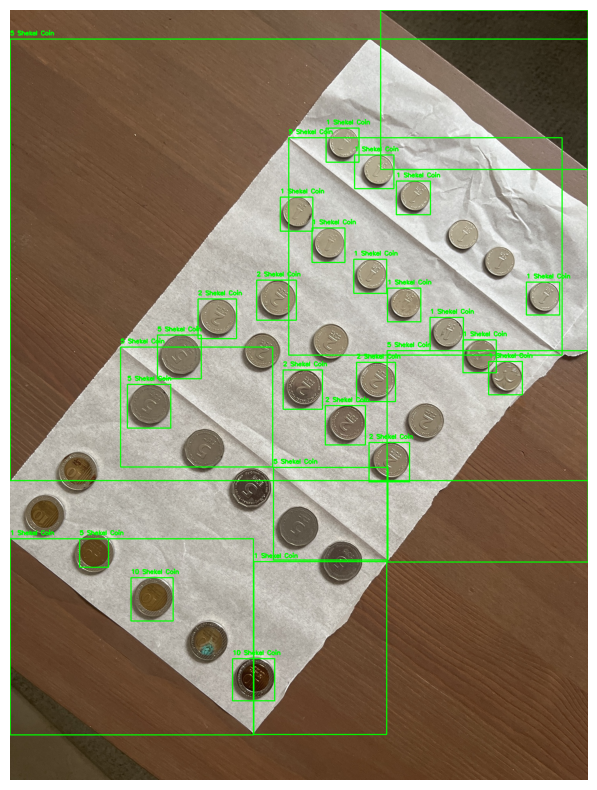

Total amount: 90 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[13  0  0  0]
 [ 0  2  0  0]
 [ 0  0  6  0]
 [ 0  0  0  9]]
1/1 [==============================] - 0s 26ms/step


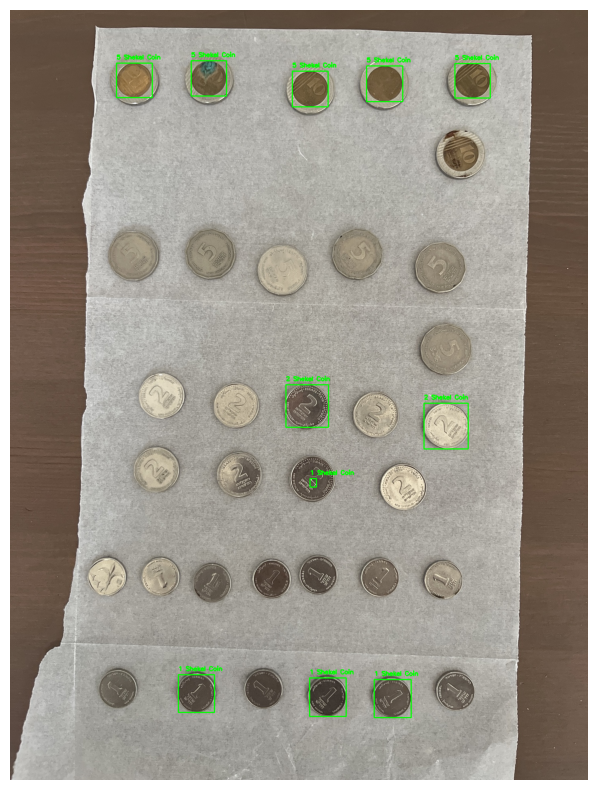

Total amount: 33 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[4 0 0]
 [0 2 0]
 [0 0 5]]
1/1 [==============================] - 0s 26ms/step


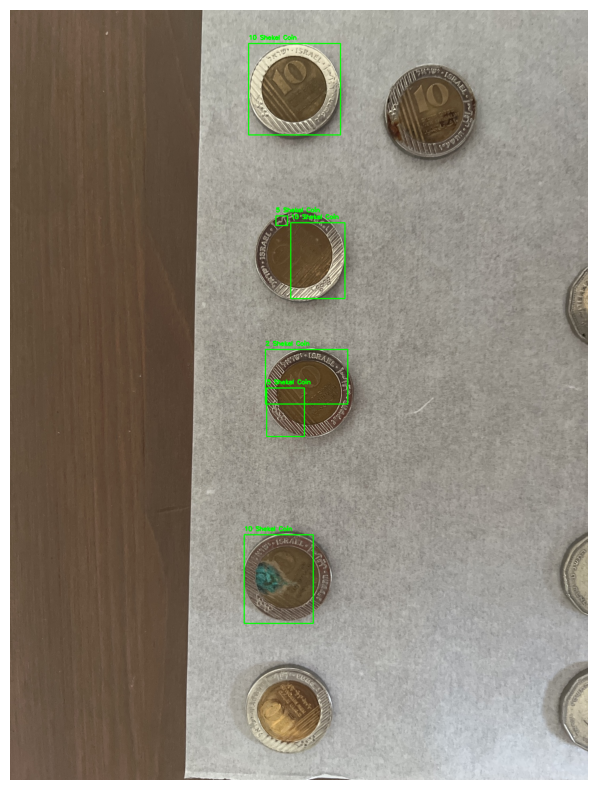

Total amount: 42 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[3 0 0]
 [0 1 0]
 [0 0 2]]
1/1 [==============================] - 0s 24ms/step


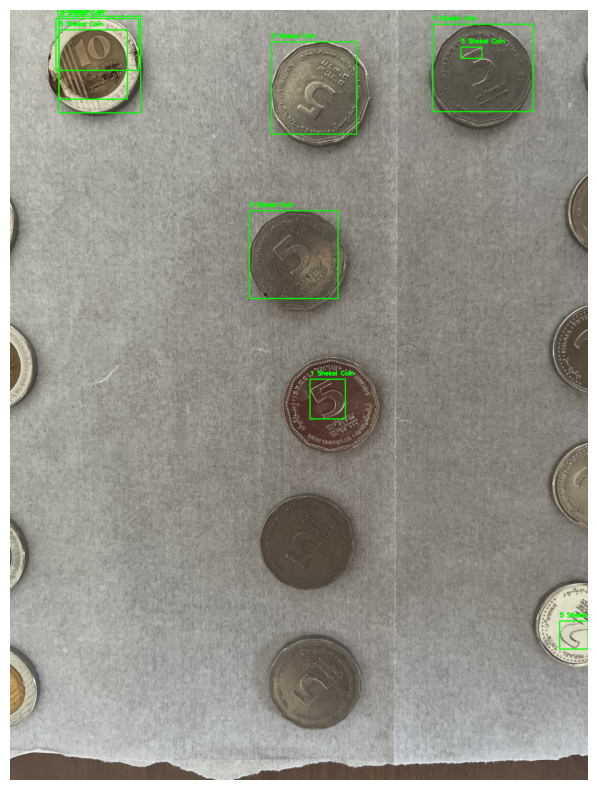

Total amount: 51 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[1 0 0]
 [0 2 0]
 [0 0 6]]
1/1 [==============================] - 0s 26ms/step


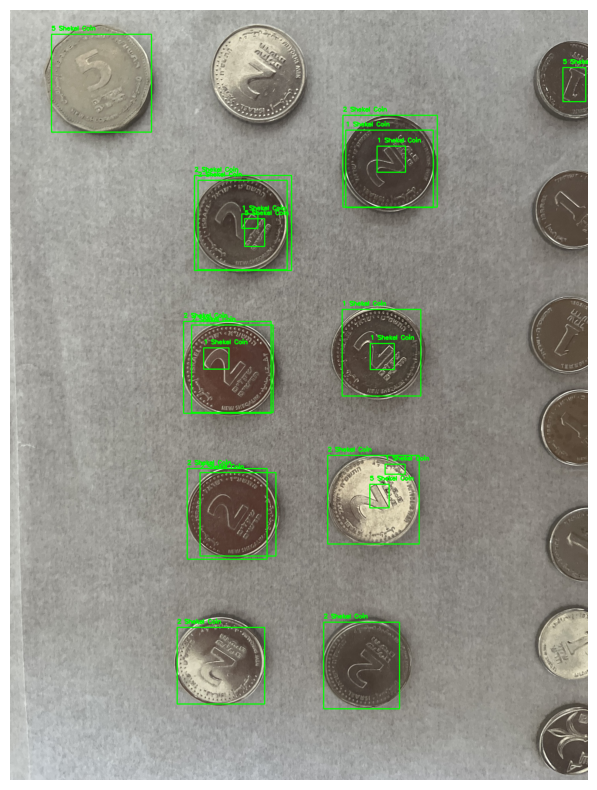

Total amount: 47 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[ 7  0  0]
 [ 0 10  0]
 [ 0  0  4]]
1/1 [==============================] - 0s 20ms/step


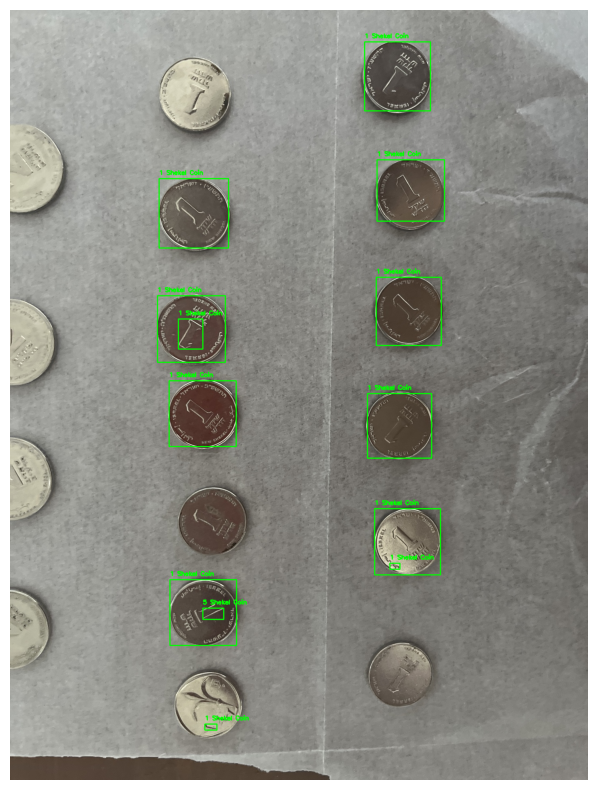

Total amount: 17 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[12  0]
 [ 0  1]]
1/1 [==============================] - 0s 28ms/step


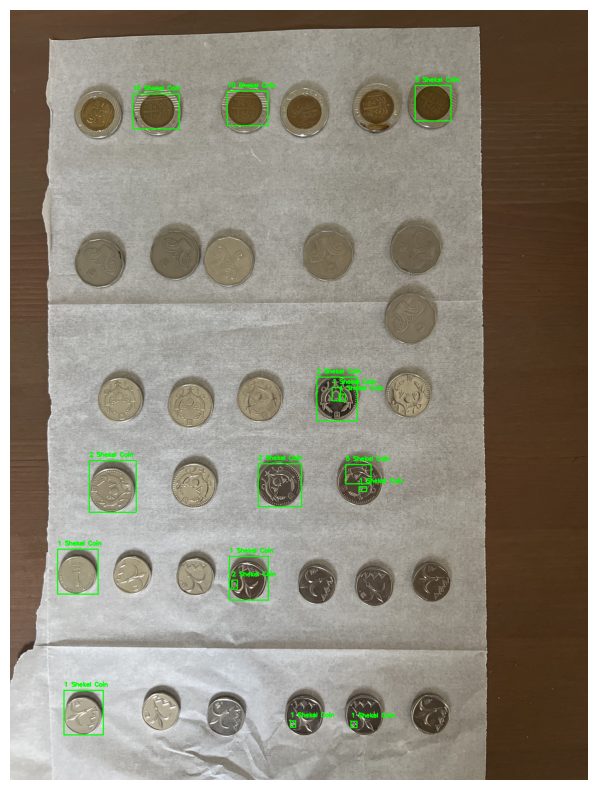

Total amount: 46 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[8 0 0 0]
 [0 2 0 0]
 [0 0 4 0]
 [0 0 0 2]]
1/1 [==============================] - 0s 28ms/step


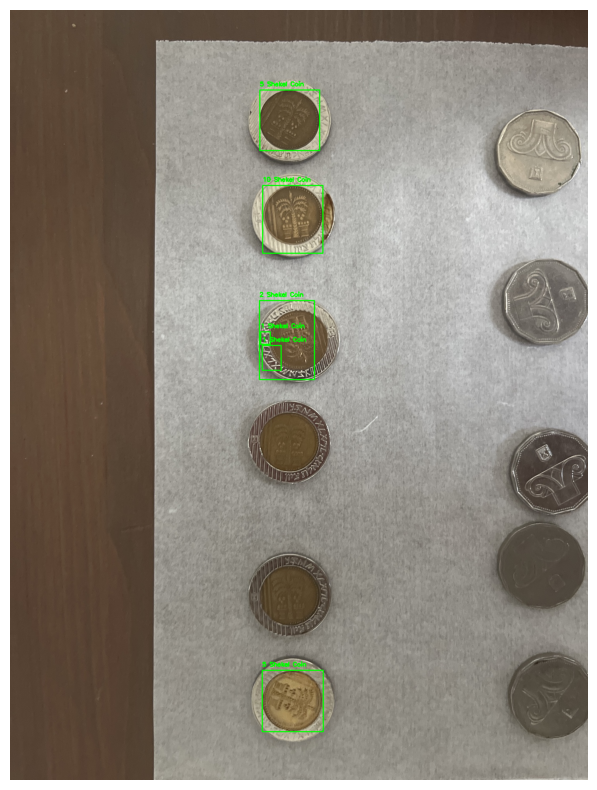

Total amount: 24 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[2 0 0 0]
 [0 1 0 0]
 [0 0 1 0]
 [0 0 0 2]]
1/1 [==============================] - 0s 66ms/step


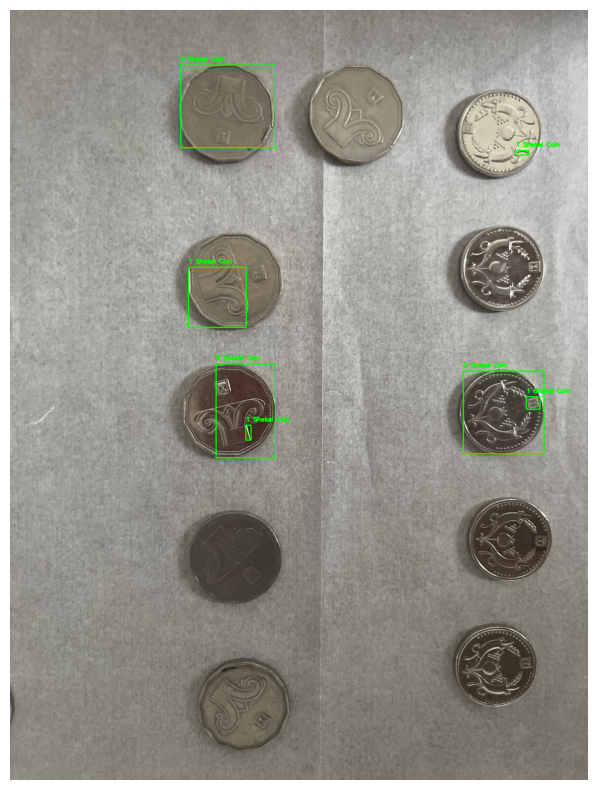

Total amount: 16 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[4 0 0]
 [0 1 0]
 [0 0 2]]
1/1 [==============================] - 0s 32ms/step


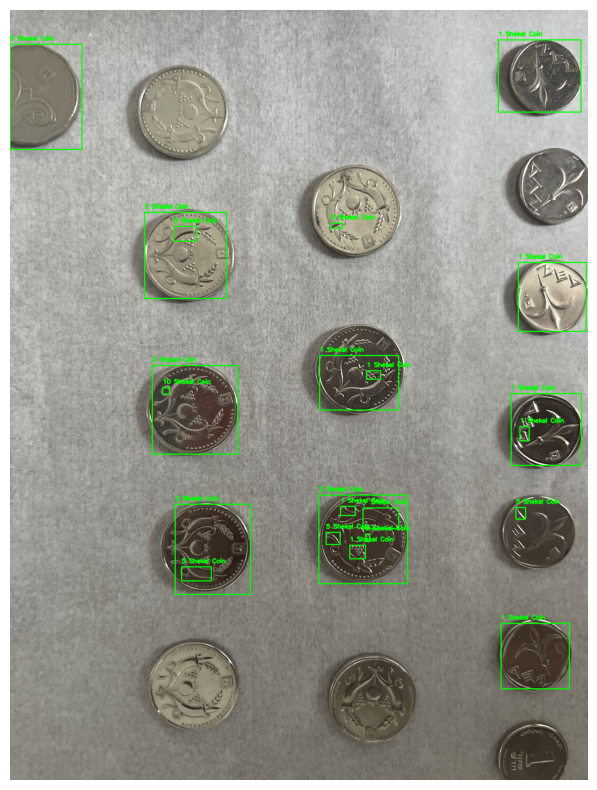

Total amount: 63 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[10  0  0  0]
 [ 0  1  0  0]
 [ 0  0  4  0]
 [ 0  0  0  7]]
1/1 [==============================] - 0s 26ms/step


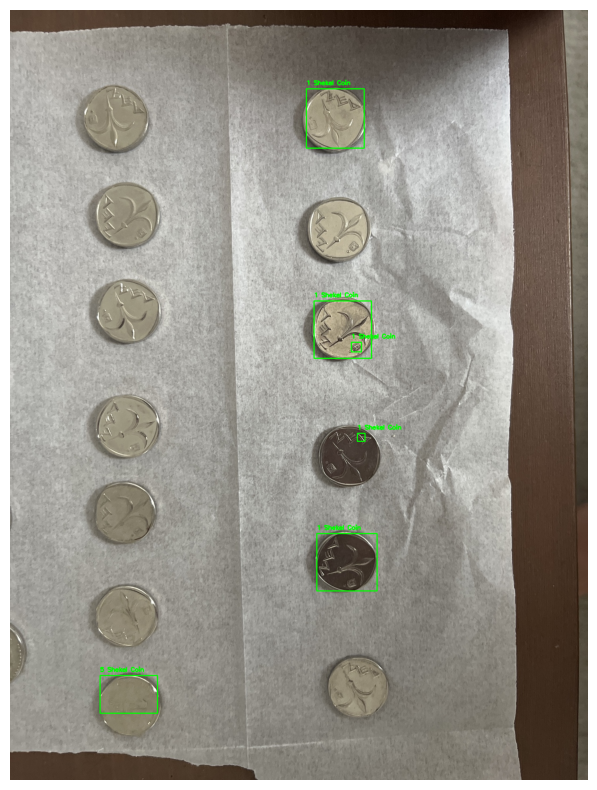

Total amount: 10 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[5 0]
 [0 1]]


In [11]:
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# Load the trained model
model = tf.keras.models.load_model('/content/drive/MyDrive/project_2_coins_labeled/coin_recognition_model_VGG16.h5')

# Define a function to preprocess the image and detect coins
def detect_and_classify_coins(image_path):
    # Load the image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    # Convert the image to grayscale and apply Gaussian blur
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (11, 11), 0)

    # Perform edge detection
    edged = cv2.Canny(blurred, 30, 150)

    # Find contours in the edged image
    contours, _ = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    total_amount = 0
    label_map_inverse = {0: '1 Shekel Coin', 1: '2 Shekel Coin', 2: '5 Shekel Coin', 3: '10 Shekel Coin'}
    value_map = {'1 Shekel Coin': 1, '2 Shekel Coin': 2, '5 Shekel Coin': 5, '10 Shekel Coin': 10}

    true_labels = []
    predicted_labels = []

    for contour in contours:
        if cv2.contourArea(contour) > 100:
            x, y, width, height = cv2.boundingRect(contour)
            coin = image_rgb[y:y+height, x:x+width]
            if coin.size == 0:
                continue
            coin_resized = cv2.resize(coin, (224, 224))
            coin_resized = np.expand_dims(coin_resized / 255.0, axis=0)

            # Predict the class of the coin
            prediction = model.predict(coin_resized)
            class_id = np.argmax(prediction, axis=1)[0]
            label = label_map_inverse[class_id]

            # Draw the bounding box and label on the image
            cv2.rectangle(image_rgb, (x, y), (x + width, y + height), (0, 255, 0), 2)
            cv2.putText(image_rgb, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

            # Sum the value of the detected coins
            total_amount += value_map[label]

            true_labels.append(label)
            predicted_labels.append(label)

    # Show the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

    print(f"Total amount: {total_amount} ILS")

    # Calculate metrics
    accuracy = accuracy_score(true_labels, predicted_labels)
    precision = precision_score(true_labels, predicted_labels, average='weighted')
    recall = recall_score(true_labels, predicted_labels, average='weighted')
    f1 = f1_score(true_labels, predicted_labels, average='weighted')
    cm = confusion_matrix(true_labels, predicted_labels)

    print(f"Accuracy: {accuracy}")
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    print(f"F1 score: {f1}")
    print("Confusion Matrix:\n", cm)

# Test the function with a new image
for test_image in os.listdir("/content/drive/MyDrive/project_2_coins_labeled/test/"):
    detect_and_classify_coins("/content/drive/MyDrive/project_2_coins_labeled/test/" + test_image)

## ResNet50

In [35]:
from tensorflow.keras.applications import ResNet50

start_time_ResNet = time.time()

def create_model(num_classes):
    base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    #base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    model = Sequential([
        base_model,
        Flatten(),
        Dense(512, activation='relu'),
        Dropout(0.5),
        Dense(128, activation='relu'),
        Dense(num_classes, activation='softmax')  # Multi-class classification
    ])
    model.compile(optimizer=Adam(learning_rate=1e-4), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model


# split, and train model
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = create_model(num_classes=4)
model.summary()

early_stopping = EarlyStopping(monitor='val_accuracy', patience=15, restore_best_weights=True)

history = model.fit(X_train, y_train, epochs=50, validation_data=(X_test, y_test), batch_size=32, callbacks=[early_stopping])

end_time_ResNet = time.time()

# Plot training and validation loss/accuracy curves
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.title('Model Accuracy')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.title('Model Loss')

plt.show()

test_loss, test_acc = model.evaluate(X_test, y_test, verbose=2)
print(f"Test accuracy: {test_acc}")

model.save('coin_recognition_model_ResNet50.h5')


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 100352)            0         
                                                                 
 dense (Dense)               (None, 512)               51380736  
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 128)               65664     
                                                                 
 dense_2 (Dense)             (None, 4)                 516       
                                                                 
Total params: 75034628 (286.23 MB)
Trainable params: 749

1/1 [==============================] - 0s 22ms/step


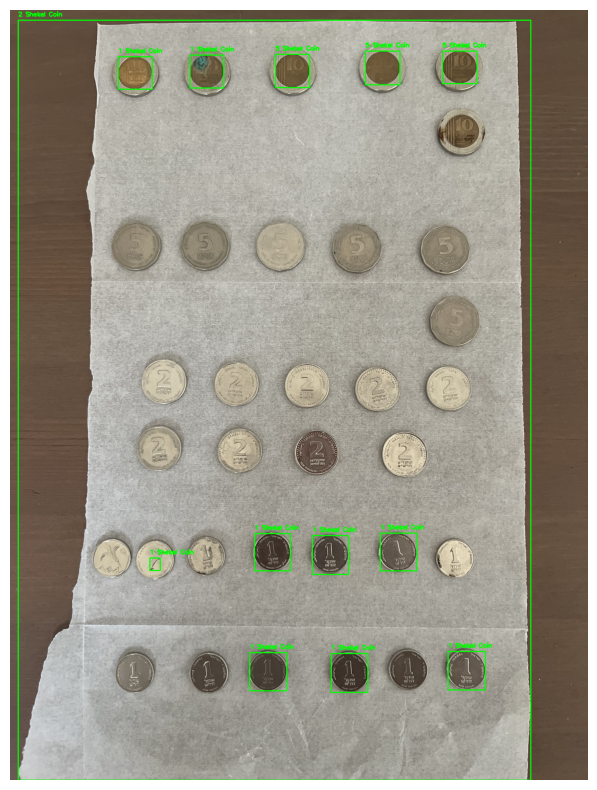

Total amount: 26 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[9 0 0]
 [0 1 0]
 [0 0 3]]
1/1 [==============================] - 0s 52ms/step


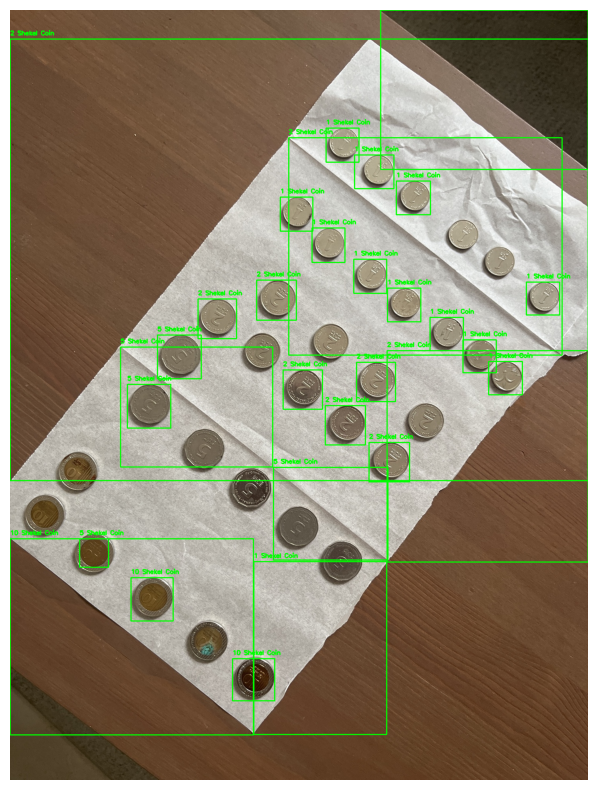

Total amount: 86 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[13  0  0  0]
 [ 0  3  0  0]
 [ 0  0  9  0]
 [ 0  0  0  5]]
1/1 [==============================] - 0s 59ms/step


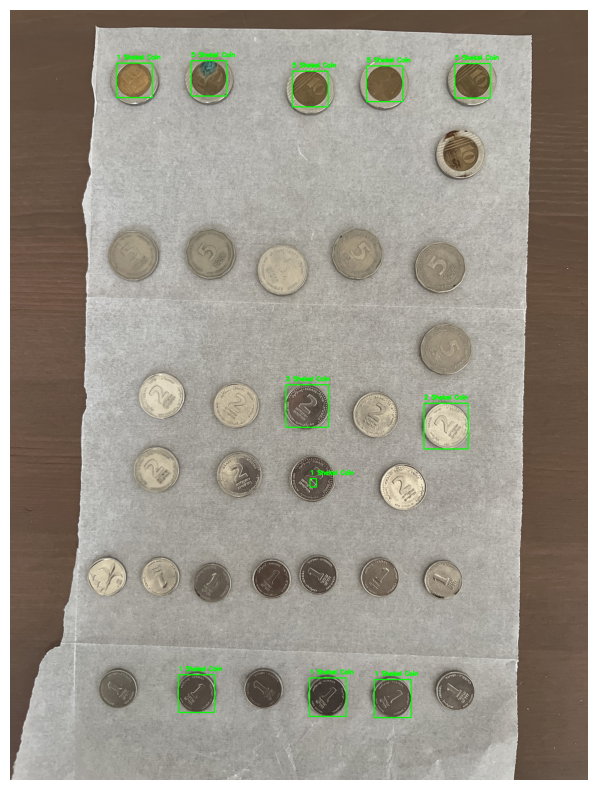

Total amount: 29 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[5 0 0]
 [0 2 0]
 [0 0 4]]
1/1 [==============================] - 0s 22ms/step


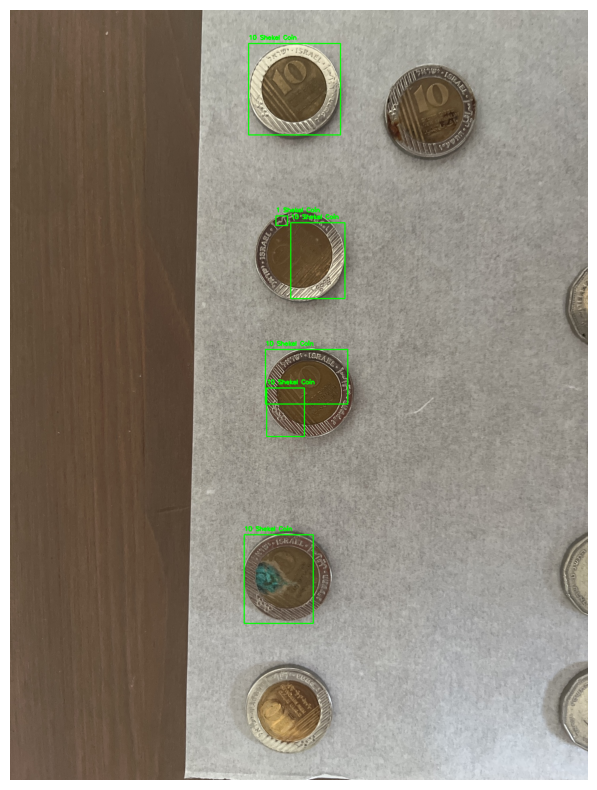

Total amount: 51 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[1 0]
 [0 5]]
1/1 [==============================] - 0s 34ms/step


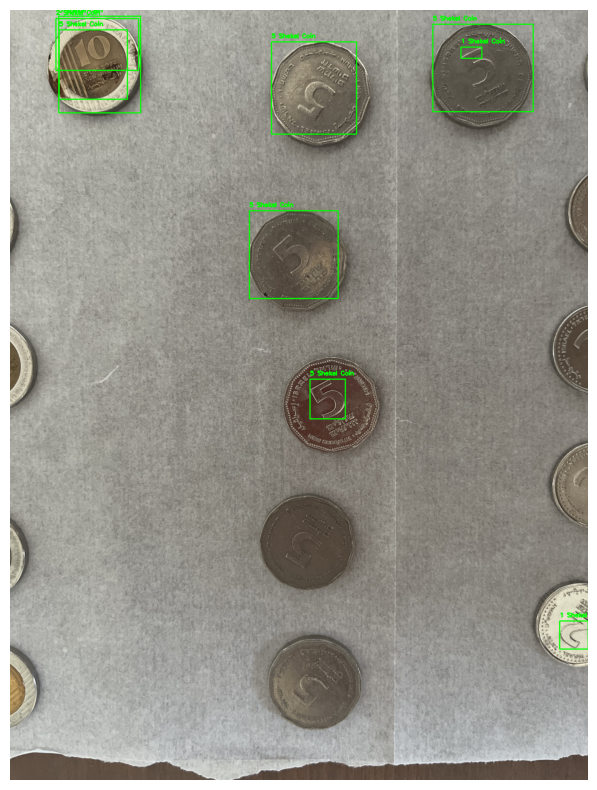

Total amount: 34 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[2 0 0]
 [0 1 0]
 [0 0 6]]
1/1 [==============================] - 0s 31ms/step


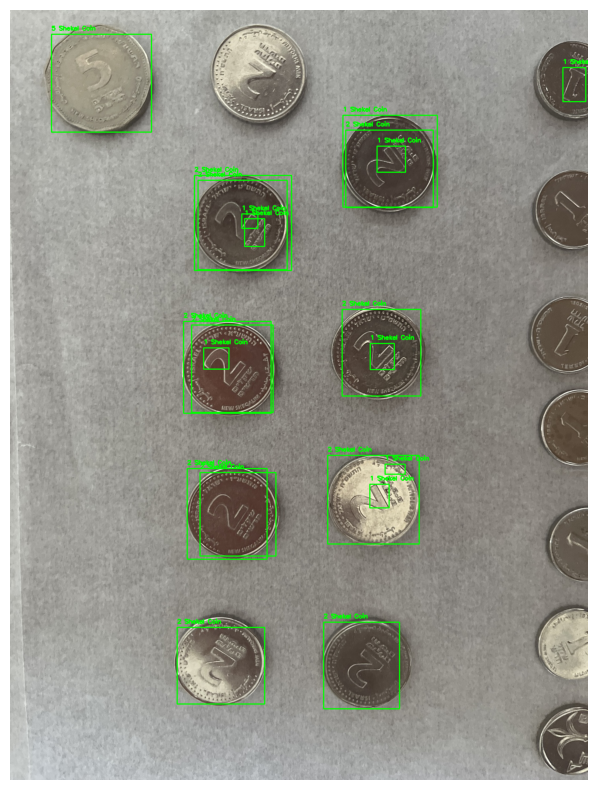

Total amount: 36 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[ 9  0  0]
 [ 0 11  0]
 [ 0  0  1]]
1/1 [==============================] - 0s 33ms/step


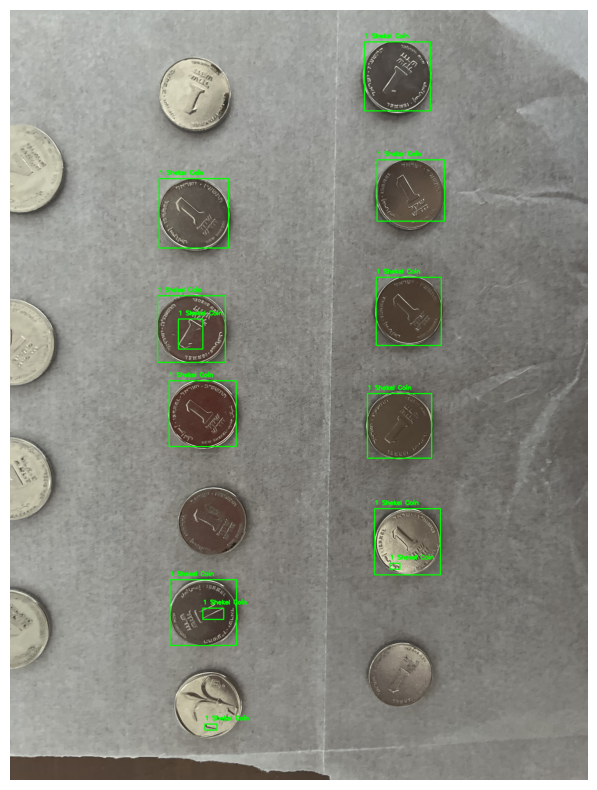

Total amount: 13 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[13]]
1/1 [==============================] - 0s 32ms/step


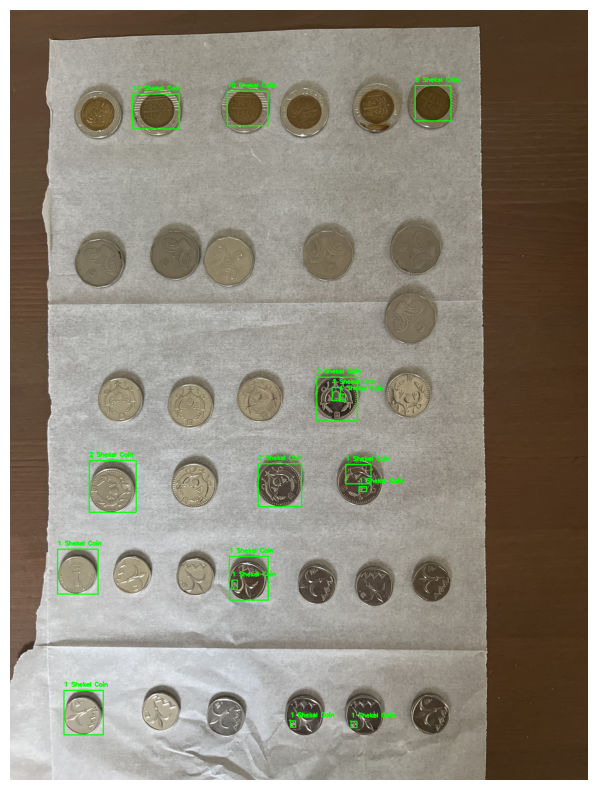

Total amount: 41 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[10  0  0  0]
 [ 0  2  0  0]
 [ 0  0  3  0]
 [ 0  0  0  1]]
1/1 [==============================] - 0s 38ms/step


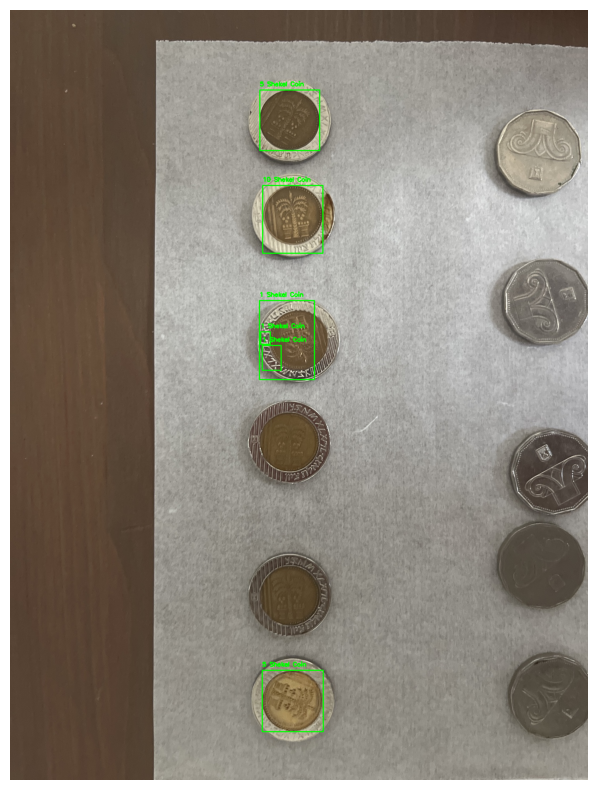

Total amount: 23 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[3 0 0]
 [0 1 0]
 [0 0 2]]
1/1 [==============================] - 0s 64ms/step


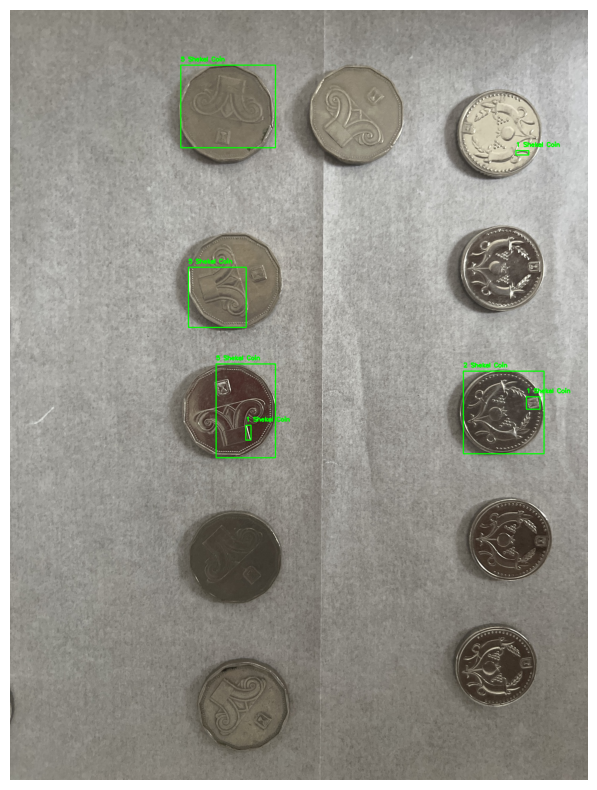

Total amount: 20 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[3 0 0]
 [0 1 0]
 [0 0 3]]
1/1 [==============================] - 0s 37ms/step


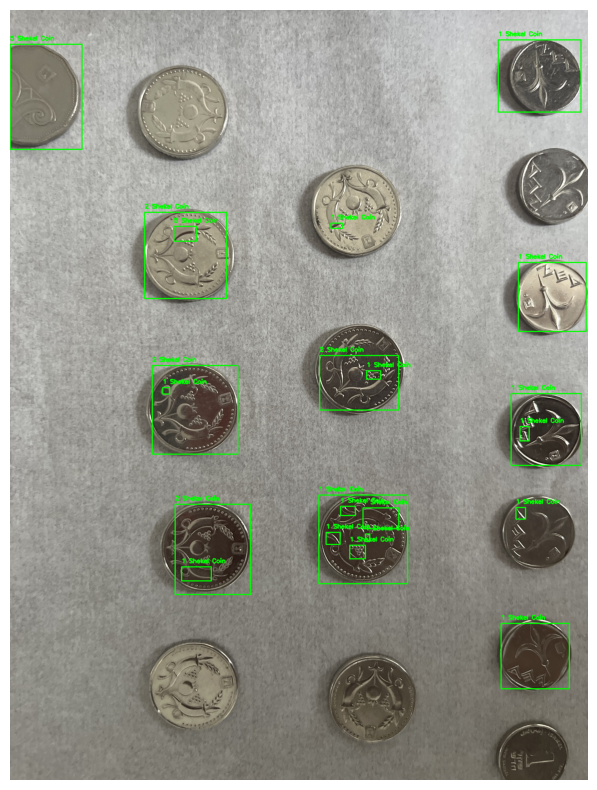

Total amount: 34 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[16  0  0]
 [ 0  4  0]
 [ 0  0  2]]
1/1 [==============================] - 0s 33ms/step


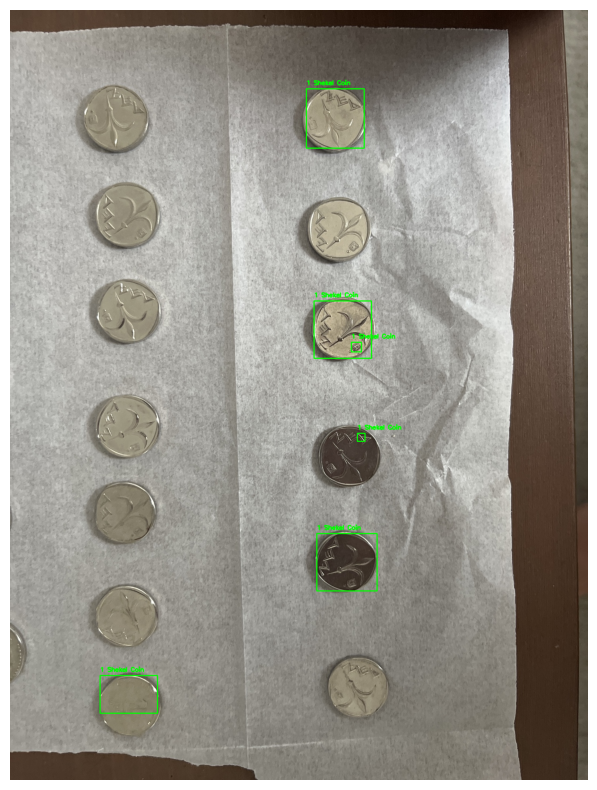

Total amount: 6 ILS
Accuracy: 1.0
Precision: 1.0
Recall: 1.0
F1 score: 1.0
Confusion Matrix:
 [[6]]


In [12]:
import cv2
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Load the trained model
model = tf.keras.models.load_model('/content/drive/MyDrive/project_2_coins_labeled/coin_recognition_model_ResNet50.h5')

# Define a function to preprocess the image and detect coins
def detect_and_classify_coins(image_path):
    # Load the image
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    # Convert the image to grayscale and apply Gaussian blur
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (11, 11), 0)

    # Perform edge detection
    edged = cv2.Canny(blurred, 30, 150)

    # Find contours in the edged image
    contours, _ = cv2.findContours(edged.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    total_amount = 0
    label_map_inverse = {0: '1 Shekel Coin', 1: '2 Shekel Coin', 2: '5 Shekel Coin', 3: '10 Shekel Coin'}
    value_map = {'1 Shekel Coin': 1, '2 Shekel Coin': 2, '5 Shekel Coin': 5, '10 Shekel Coin': 10}

    true_labels = []
    predicted_labels = []

    for contour in contours:
        if cv2.contourArea(contour) > 100:
            x, y, width, height = cv2.boundingRect(contour)
            coin = image_rgb[y:y+height, x:x+width]
            if coin.size == 0:
                continue
            coin_resized = cv2.resize(coin, (224, 224))
            coin_resized = np.expand_dims(coin_resized / 255.0, axis=0)

            # Predict the class of the coin
            prediction = model.predict(coin_resized)
            class_id = np.argmax(prediction, axis=1)[0]
            label = label_map_inverse[class_id]

            # Draw the bounding box and label on the image
            cv2.rectangle(image_rgb, (x, y), (x + width, y + height), (0, 255, 0), 2)
            cv2.putText(image_rgb, label, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

            # Sum the value of the detected coins
            total_amount += value_map[label]

            true_labels.append(label)
            predicted_labels.append(label)

    # Show the image with bounding boxes
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

    print(f"Total amount: {total_amount} ILS")

    # Calculate metrics
    accuracy = accuracy_score(true_labels, predicted_labels)
    precision = precision_score(true_labels, predicted_labels, average='weighted')
    recall = recall_score(true_labels, predicted_labels, average='weighted')
    f1 = f1_score(true_labels, predicted_labels, average='weighted')
    cm = confusion_matrix(true_labels, predicted_labels)

    print(f"Accuracy: {accuracy}")
    print(f"Precision: {precision}")
    print(f"Recall: {recall}")
    print(f"F1 score: {f1}")
    print("Confusion Matrix:\n", cm)

# Test the function with a new image
for test_image in os.listdir("/content/drive/MyDrive/project_2_coins_labeled/test/"):
    detect_and_classify_coins("/content/drive/MyDrive/project_2_coins_labeled/test/" + test_image)

In [ ]:
# compare time
VGG_time = end_time_VGG - start_time_VGG
ResNet_time = end_time_ResNet - start_time_ResNet

print(f"VGG16 time: {VGG_time} seconds")
print(f"ResNet50 time: {ResNet_time} seconds")


VGG16 time: 621.9427452087402 seconds
ResNet50 time: 646.1170649528503 seconds


# VGG16 and ResNet50 Results
We can use the confusion metrics as well as other parameters of the models to evaluate their ability to recognize and classify different coin denominations.
The training process is visualized with plots showing the improvement in accuracy over epochs, and early stopping ensures that the best model is retained.
Both models achieved mediocre accuracy on the validation set, but overall they are not accurate - we can see how poorly they performed on the test set.  

We will now proceed to a different object recognition model - YOLOv5 and test its ability in recognising Israeli Shekel coins.

# 2c: Yolov5
Code for Yolov5 is based on:
https://github.com/niconielsen32/NeuralNetworks/blob/main/MugDetector.ipynb

In [13]:
#clone YOLOv5 and
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow
!pip install roboflow



Cloning into 'yolov5'...
remote: Enumerating objects: 16818, done.
remote: Counting objects: 100% (359/359), done.
remote: Compressing objects: 100% (265/265), done.
remote: Total 16818 (delta 196), reused 185 (delta 94), pack-reused 16459
Receiving objects: 100% (16818/16818), 15.58 MiB | 17.55 MiB/s, done.
Resolving deltas: 100% (11499/11499), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 824.8/824.8 kB 26.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 60.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the fo

In [14]:
import torch
import os
from IPython.display import Image, clear_output  # to display images
from roboflow import Roboflow

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")


Setup complete. Using torch 2.3.1+cu121 (Tesla T4)


In [15]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"


In [16]:
rf = Roboflow(api_key="QWFoLtS9TPf5fCd9PH68") # key to my private library in roboflow for the coin counter project
project = rf.workspace("student-t2nxm").project("coin-sorter-7nczd")
version = project.version(2)
dataset = version.download("yolov5")


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to /content/datasets/coin-sorter-2 in yolov5pytorch:: 100%|██████████| 1639/1639 [00:01<00:00, 1232.07it/s]


In [ ]:
#Train model using yolo
start_time_yolo = time.time()
!python train.py --img 416 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache


2024-07-23 11:25:28.117462: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-23 11:25:28.117511: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-23 11:25:28.119143: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=/content/datasets/coin-sorter-2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scal

In [ ]:
#Show Training Results

# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# Prediction for the validation set
!python detect.py --weights runs/train/exp2/weights/best.pt --img 416 --conf 0.2 --source {dataset.location}/valid/images --agnostic-nms

end_time_yolo = time.time()

detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/datasets/coin-sorter-2/valid/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=True, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-347-gd6112173 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/43 /content/datasets/coin-sorter-2/valid/images/0439869b-IMG-20240718-WA0022_jpg.rf.7929e0f619d4e6732531be7b88702470.jpg: 416x416 1 2 Shekel Coin, 1 5 Shekel Coin, 7.1ms
image 2/43 /content/datasets/coin-sorter-2/valid/images/079f5a66-ido_29_jpg.rf.0ee1f4

In [ ]:
# Prediction for the test set
#!python /content/yolov5/detect.py --weights /content/best.pt --img 416 --conf 0.2 --source /content/datasets/coin-sorter-2/test/images --save-txt --save-conf --agnostic-nms
!python detect.py --weights runs/train/exp2/weights/best.pt --img 416 --conf 0.2 --source /content/datasets/coin-sorter-2/test/images --save-txt --save-conf --agnostic-nms


detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/datasets/coin-sorter-2/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=True, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-347-gd6112173 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/21 /content/datasets/coin-sorter-2/test/images/04bbb065-6402E914-0795-46B9-B6A7-5101B511DBFF_JPG.rf.4c8f985072b2d818abad456ccd34cae7.jpg: 416x416 1 1 Shekel Coin, 1 5 Shekel Coin, 10.8ms
image 2/21 /content/datasets/coin-sorter-2/test/images/05ea63d7-IMG_301

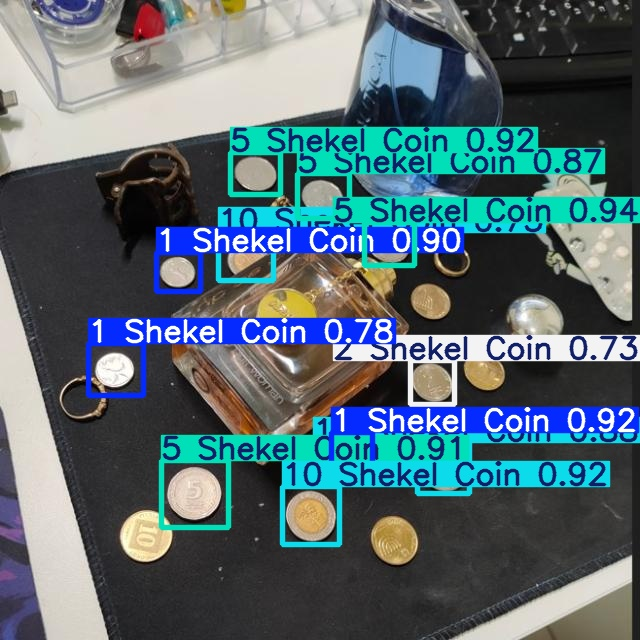

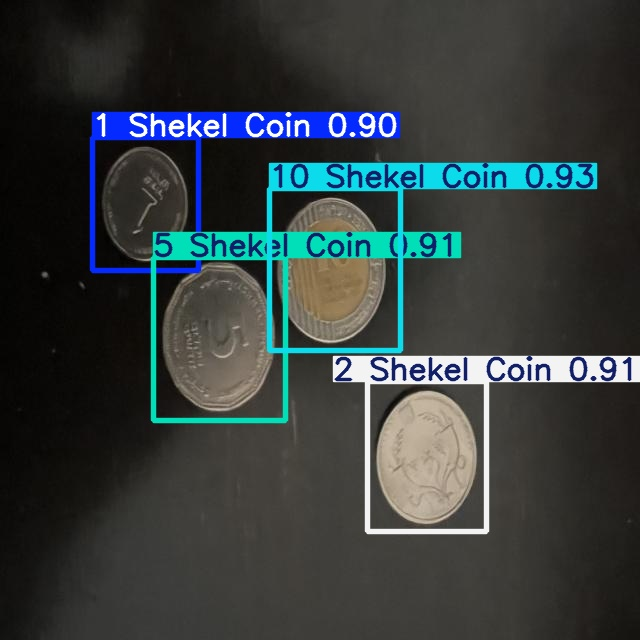

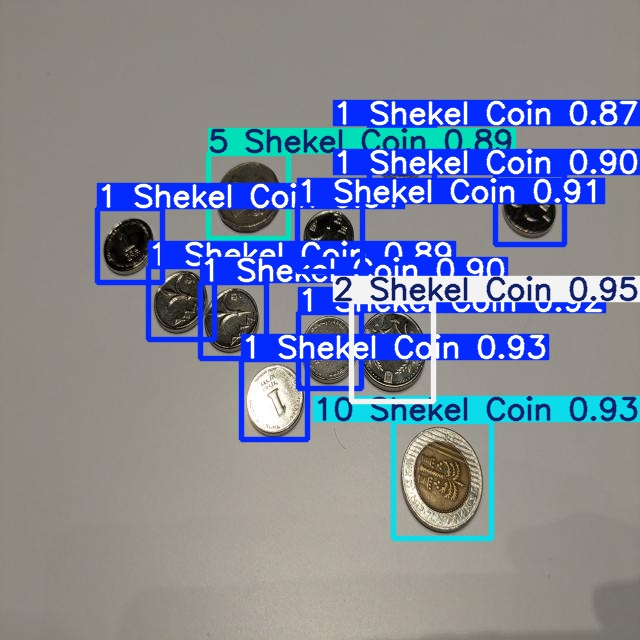

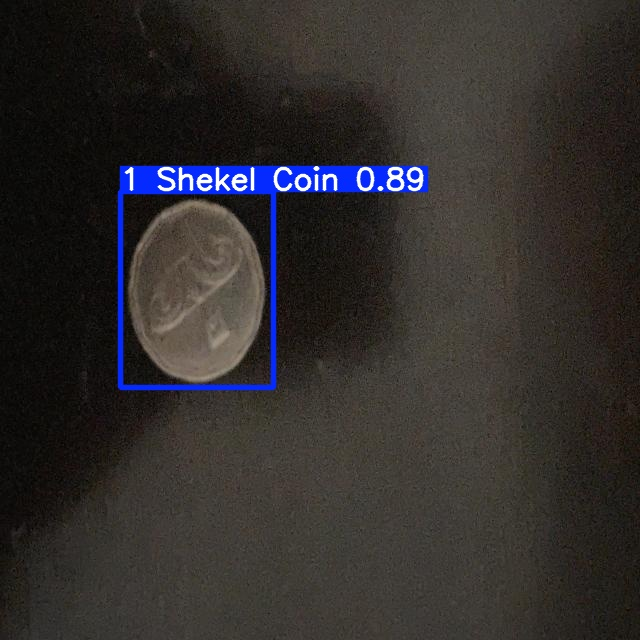

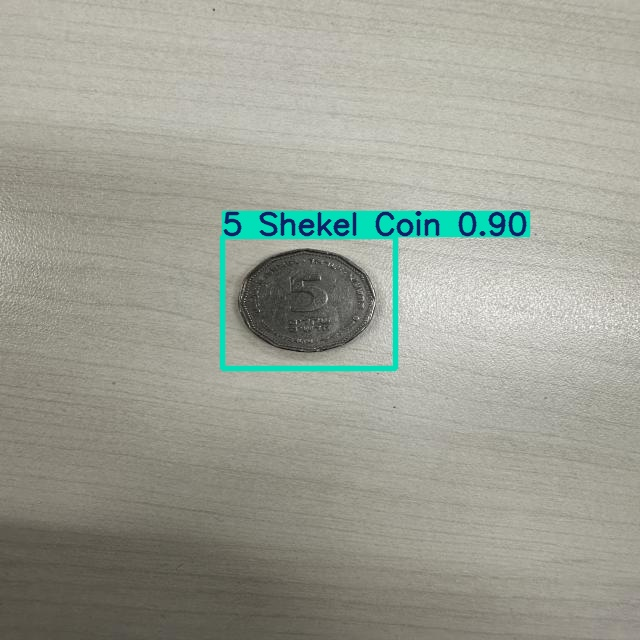

...

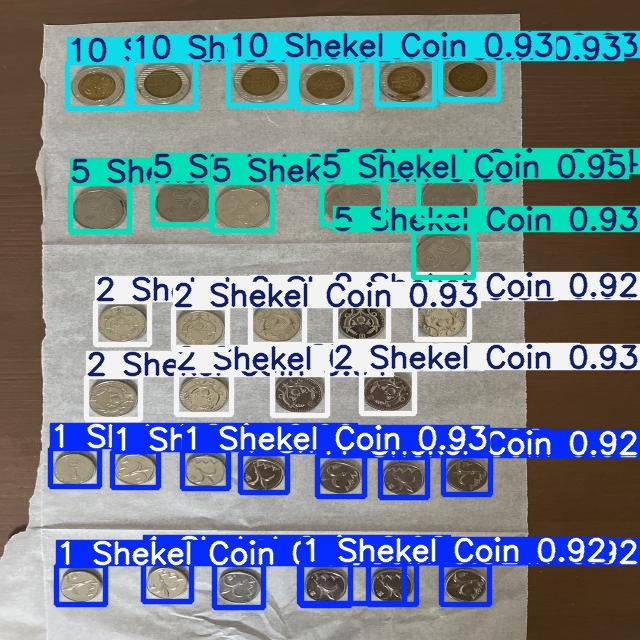

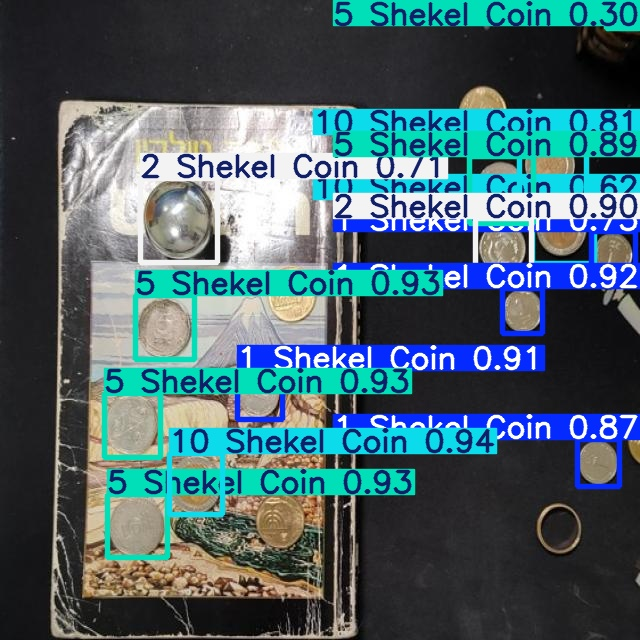

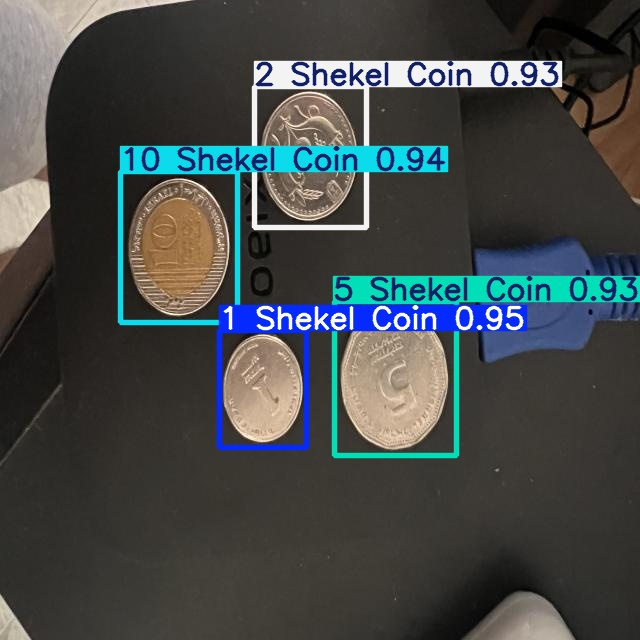

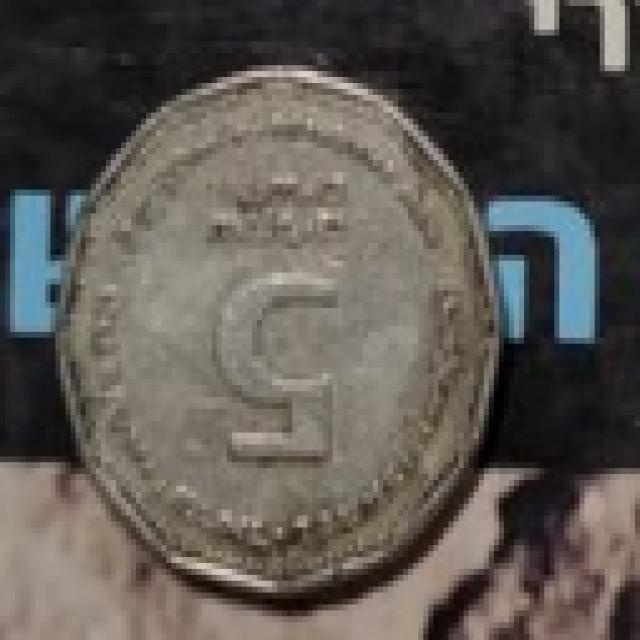

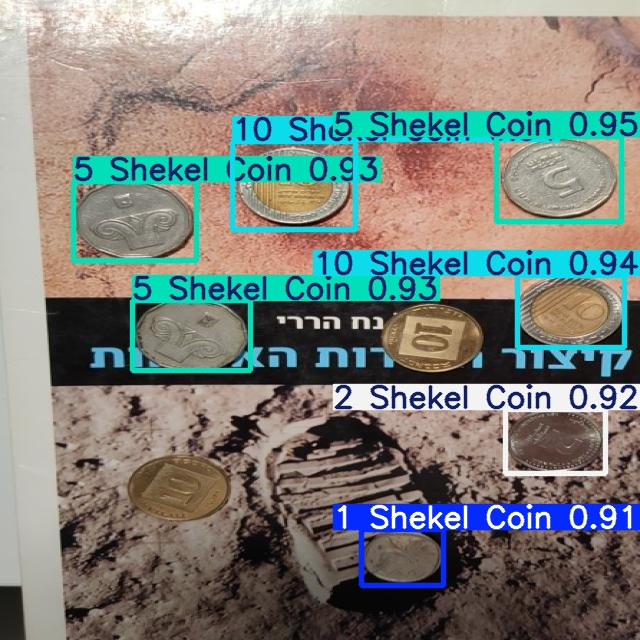

In [ ]:
# Display Inference Images - quick and dirty

import glob
from IPython.display import Image, display

i = 0
# Choose the correct exp folder - see prev output block
for imageName in glob.glob('/content/yolov5/runs/detect/exp6/*.jpg'): #assuming JPG
  display(Image(filename=imageName))


In [25]:
# Save Model

#export your model's weights for future use
from google.colab import files
files.download('content/yolov5/runs/train/exp2/weights/best.pt')

FileNotFoundError: Cannot find file: content/yolov5/runs/train/exp2/weights/best.pt

In [17]:
import cv2
import torch
import json
import os
import numpy as np
import requests


# load the model
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/drive/MyDrive/project_2_coins_labeled/best.pt')
model.agnostic = True #we only want one box per item

#image_path = '/content/drive/MyDrive/project_2_coins_labeled/test/Image.jpeg'
image_path = '/content/datasets/coin-sorter-2/test/images/04bbb065-6402E914-0795-46B9-B6A7-5101B511DBFF_JPG.rf.4c8f985072b2d818abad456ccd34cae7.jpg'

# Load the image using OpenCV and convert to RGB
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Pass the image as a NumPy array to the model
results = model(img)
detections = results.pandas().xyxy[0]

# our class definition of whekel coins (class:numismatics)
Shekel_Values = {0:1, 1:10, 2:2, 3:5}

def get_sum_of_coins(detections):
    value_sum = detections['class'].map(Shekel_Values).sum()
    return value_sum

# calculate sum of coins
predicted_sum = get_sum_of_coins(detections)
print(f"Sum of Shekel coins in image:",predicted_sum,'₪')

You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2024-7-24 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7020913 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 
WARNING ⚠️ NMS time limit 0.550s exceeded


Sum of Shekel coins in image: 6 ₪


In [18]:
results.pandas().xyxy[0]

,xmin,ymin,xmax,ymax,confidence,class,name
0,317.764191,251.053635,410.087372,370.065521,0.930268,0,1 Shekel Coin
1,102.772354,238.621735,219.787155,388.699249,0.926682,3,5 Shekel Coin


In [31]:
# let's calculate the accuracy of the prediction for all test images
# we will calculate the true_sum and predicted_sum for each image in the test set, and evaluate the accuracy

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

# Define the base path for your dataset
base_path = '/content/datasets/coin-sorter-2/test/'


# Checks if a file is empty using os.path.getsize, returns True if the file is empty and False otherwise.
def is_empty_file(file_path):
  try:
    file_size = os.path.getsize(file_path)
    return file_size == 0  # Check if file size is 0 bytes
  except FileNotFoundError:
    # Handle case where file doesn't exist (optional)
    return False  # Assuming non-existent file is not empty (modify as needed)


# Function to read labels from a TXT file
def read_label(image_name):
  label_path = image_name[:-3]+"txt"
  label_path = base_path+'labels/'+label_path
  #print("label_path",label_path)
  if is_empty_file(label_path):
    return None  # Return None if the file is empty
  else:
    try:
      with open(label_path, 'r') as f:
        lines = f.readlines()
        coin_classes = [int(line[0]) for line in lines if line[0].isdigit()]  # Extract first digit (if exists) as class
        #print(coin_classes)
        #switch to coin_value
        coin_values = [Shekel_Values.get(num, "Unknown Value") for num in coin_classes]
        #print(coin_values)
        if coin_values:
          # Calculate sum if all lines contain digits
          true_sum = sum(coin_values)
          return true_sum
        else:
          print(f"Warning: Non-digit labels found in {image_name}.txt, skipping.")
          return None
    except FileNotFoundError:
      print(f"Warning: Label file not found for {image_name}.")
      return None


# Function to calculate the accuracy of the prediction
def get_accuracy(true_sum, predicted_sum):
  if true_sum == None: #if there are no coins in the picture
    if predicted_sum == 0: # accuracy is 1 if the model correctly mentioned that there are no coins
      accuracy = 1
    else: # accuracy is zero if the model falsly predicted coins
      accuracy = 0
  else:
    accuracy = 1 - ((abs(true_sum - predicted_sum)) / true_sum)
  return(round(accuracy,2))




# Create dictionaries mapping image names to their coin values true_sum, pred_sum and prediction_accuracy
image_true_sums = {}
image_pred_sums = {}
prediction_accuracy = {}

for image_file in os.listdir(os.path.join(base_path, 'images')):
  #print("image_file",image_file)
  true_sum = read_label(image_file)
  image_true_sums[image_file] = true_sum # where a None value coreresponds to no coins in image

  # get the predicted_sum for each image in the test set
  # Load the image using OpenCV and convert to RGB
  img = cv2.imread(base_path+'images/'+image_file)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)


  # Pass the image as a NumPy array to the model
  results = model(img)
  detections = results.pandas().xyxy[0]

  # our class definition of whekel coins (class:numismatics)
  Shekel_Values = {0:1, 1:10, 2:2, 3:5}

  def get_sum_of_coins(detections):
      value_sum = detections['class'].map(Shekel_Values).sum()
      return value_sum

  # calculate sum of coins
  predicted_sum = get_sum_of_coins(detections)
  #print(f"Sum of Shekel coins in image:",predicted_sum,'₪')
  image_pred_sums[image_file] = predicted_sum # where a None value coreresponds to no coins in image

  prediction_accuracy[image_file]=get_accuracy(true_sum, predicted_sum)

'''# Create lists for true and predicted sums
true_sums = [x if x is not None else 0 for x in image_true_sums.values()]
predicted_sums = [x if x is not None else 0 for x in image_pred_sums.values()]

# Create a confusion matrix
conf_mat = confusion_matrix(true_sums, predicted_sums)

# Print the confusion matrix
print(conf_mat)

# Calculate the classification report
report = classification_report(true_sums, predicted_sums)

# Print the classification report
print(report)'''

# Print the accuracy of the test images
print(f"Average Accuracy of Test Images:", round(np.array(list(prediction_accuracy.values())).mean(),2))


Average Accuracy of Test Images: 0.8


image_true_sums 46
image_pred_sums 66
prediction_accuracy 0.57


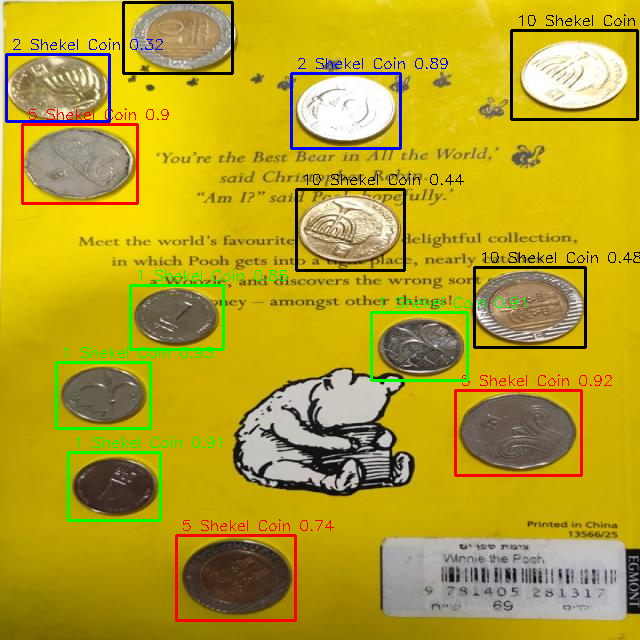



image_true_sums None
image_pred_sums 0
prediction_accuracy 1


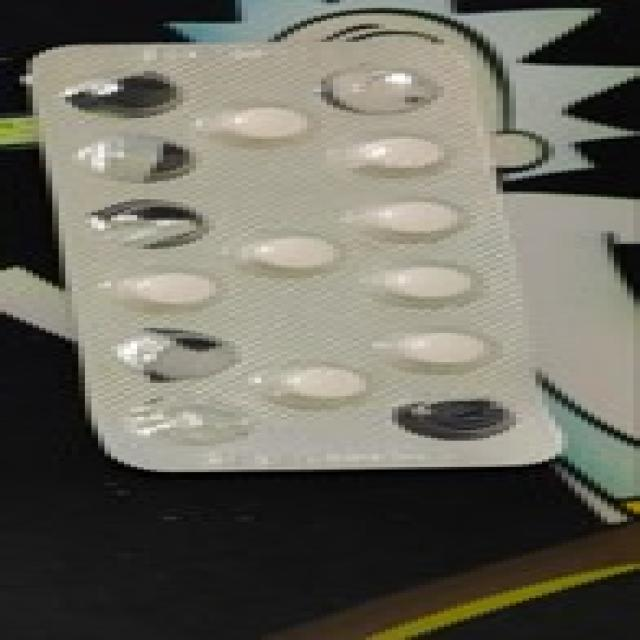



image_true_sums 5
image_pred_sums 10
prediction_accuracy 0.0


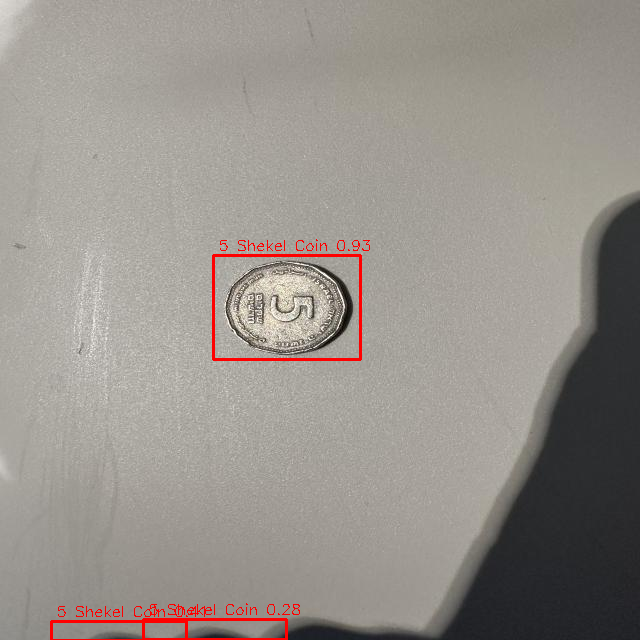



image_true_sums 15
image_pred_sums 15
prediction_accuracy 1.0


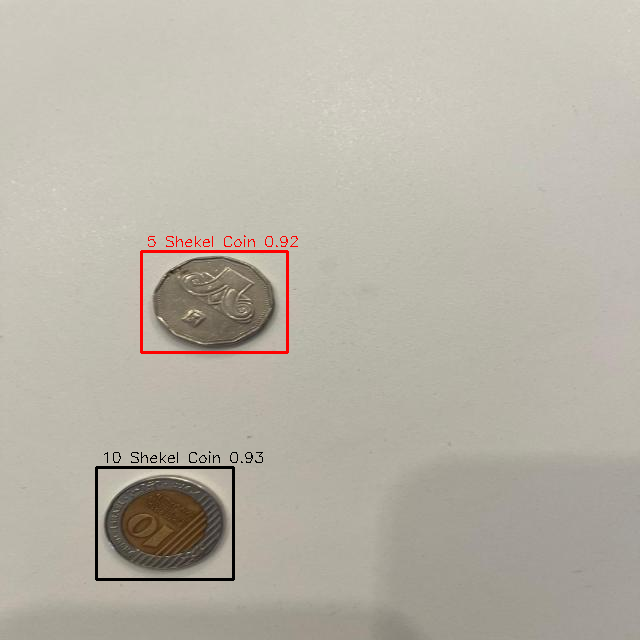



image_true_sums 17
image_pred_sums 17
prediction_accuracy 1.0


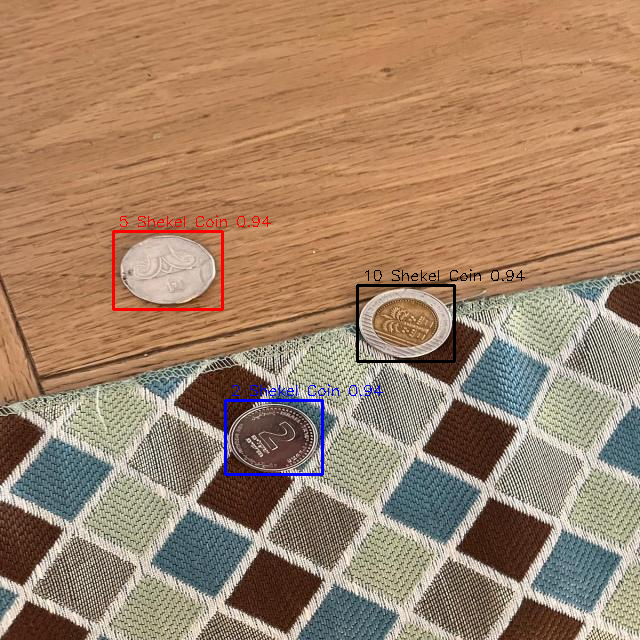



image_true_sums 35
image_pred_sums 25
prediction_accuracy 0.71


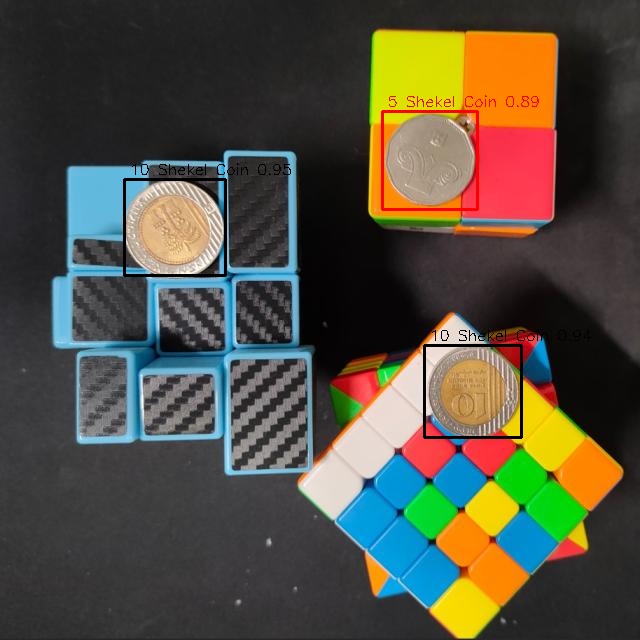



image_true_sums 10
image_pred_sums 10
prediction_accuracy 1.0


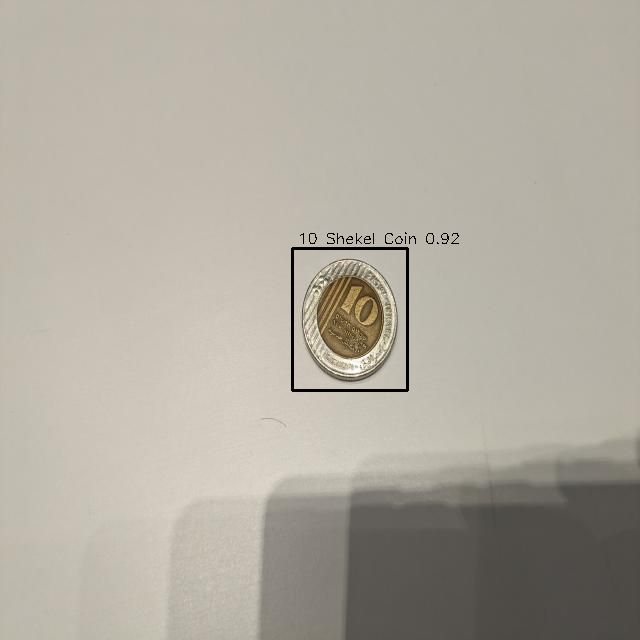



image_true_sums 18
image_pred_sums 26
prediction_accuracy 0.56


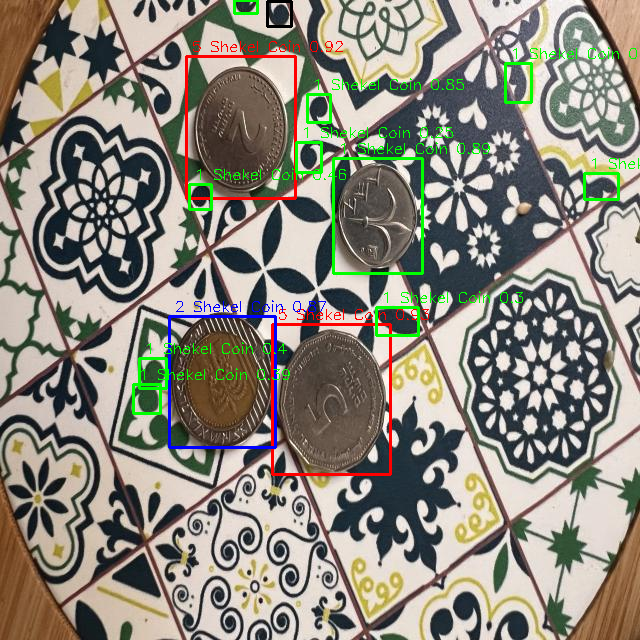



image_true_sums 18
image_pred_sums 22
prediction_accuracy 0.78


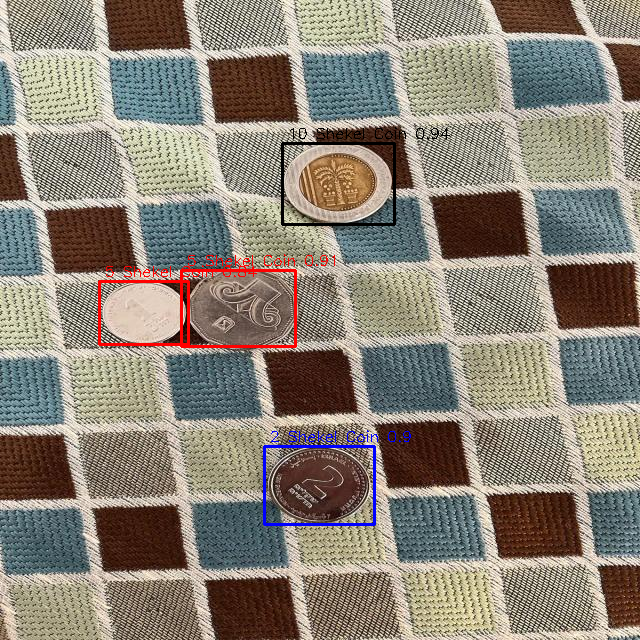



image_true_sums 25
image_pred_sums 29
prediction_accuracy 0.84


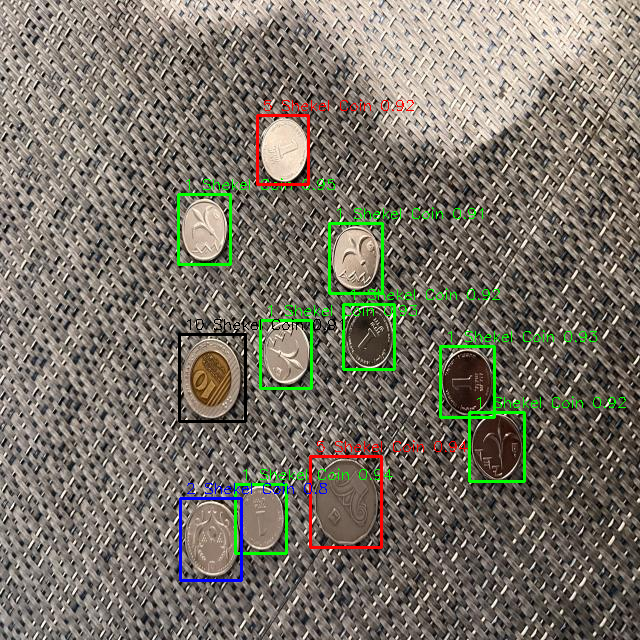



image_true_sums 10
image_pred_sums 10
prediction_accuracy 1.0


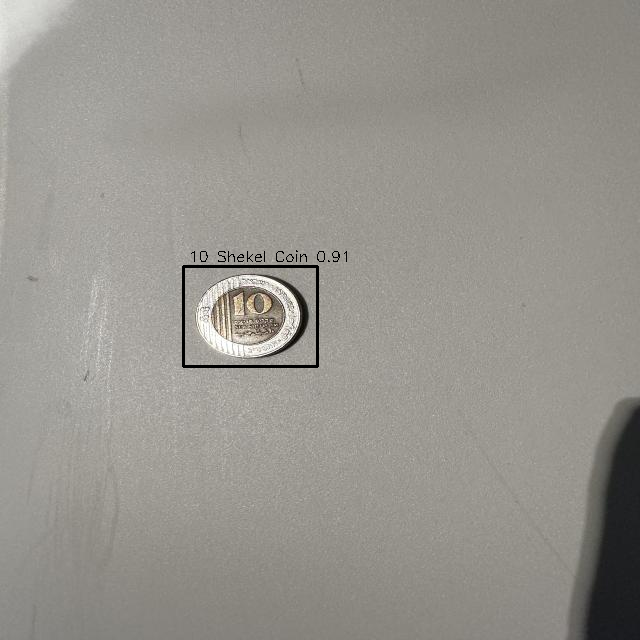



image_true_sums 40
image_pred_sums 42
prediction_accuracy 0.95


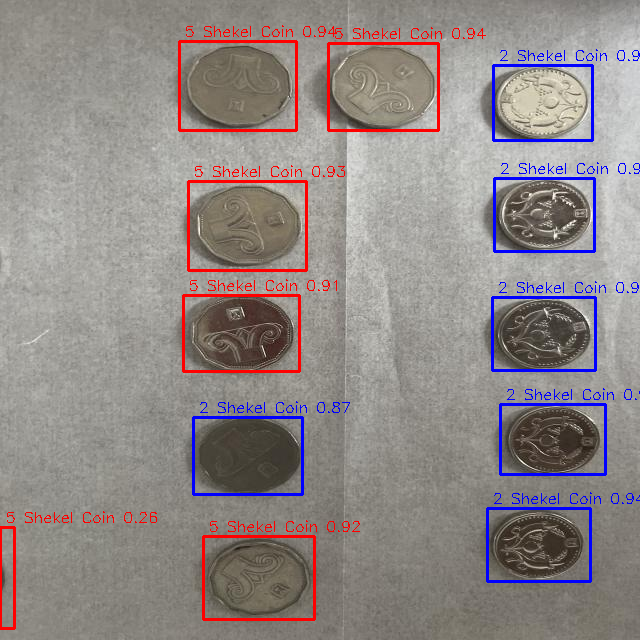



image_true_sums 51
image_pred_sums 97
prediction_accuracy 0.1


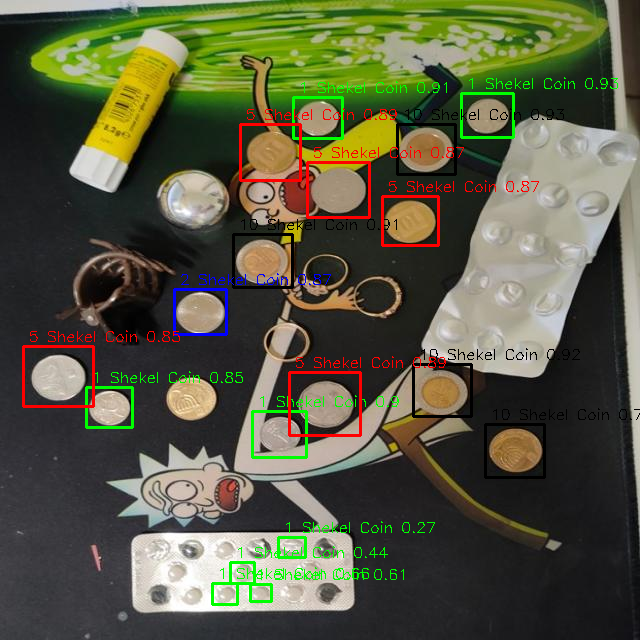



image_true_sums 51
image_pred_sums 71
prediction_accuracy 0.61


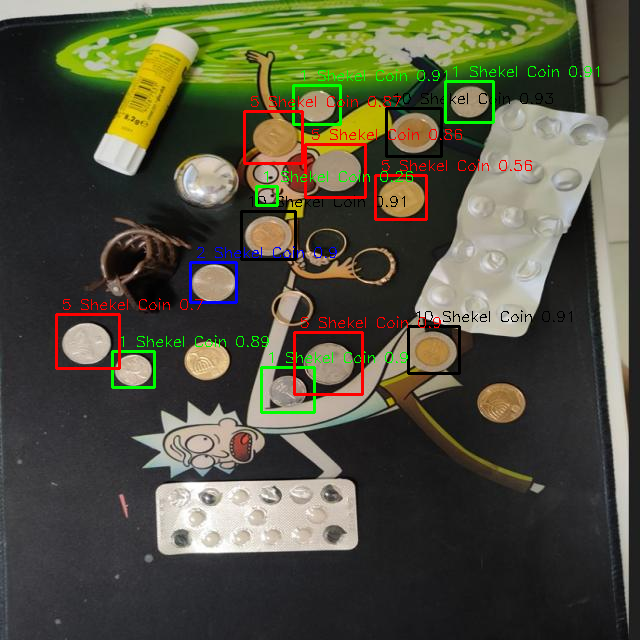



image_true_sums 46
image_pred_sums 46
prediction_accuracy 1.0


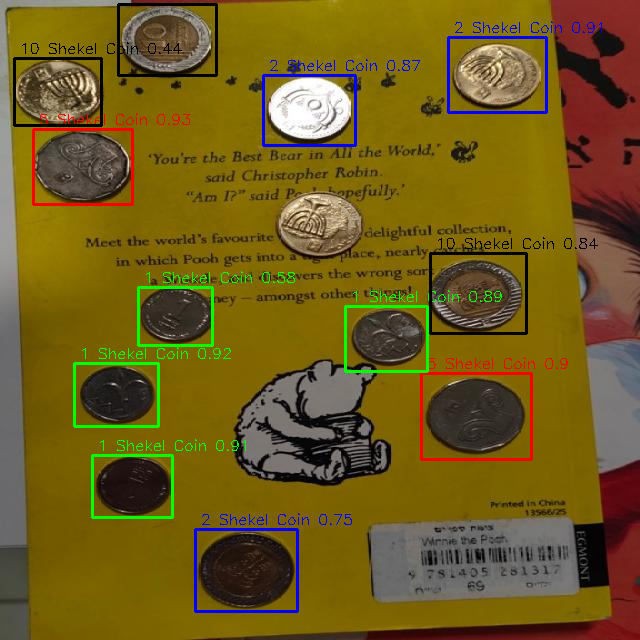



image_true_sums 1
image_pred_sums 1
prediction_accuracy 1.0


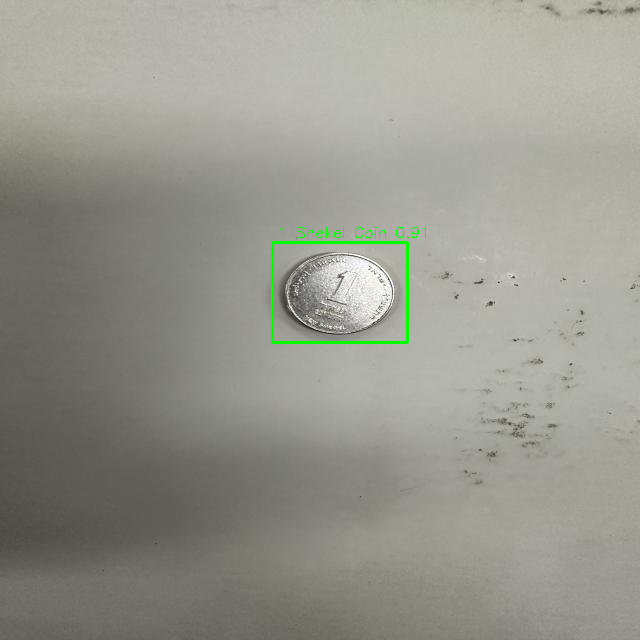



image_true_sums 11
image_pred_sums 11
prediction_accuracy 1.0


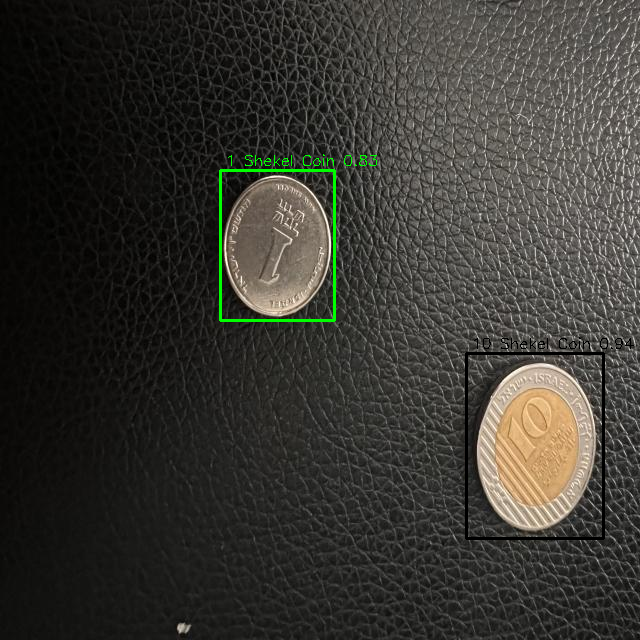



image_true_sums 16
image_pred_sums 16
prediction_accuracy 1.0


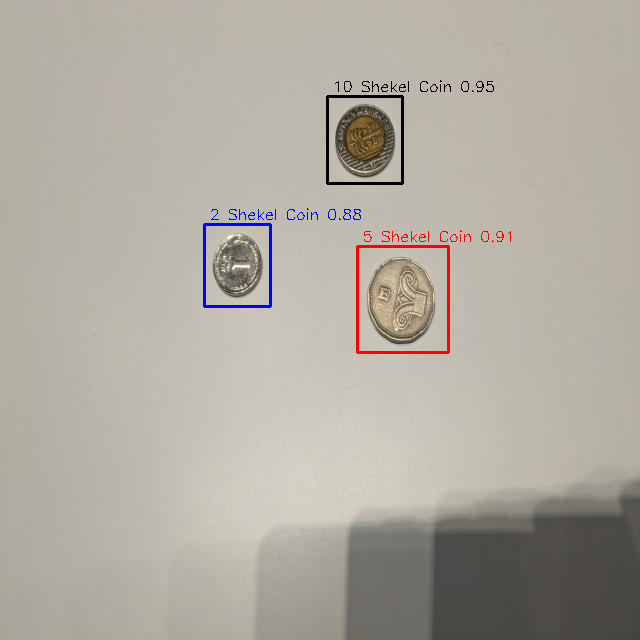



image_true_sums 25
image_pred_sums 26
prediction_accuracy 0.96


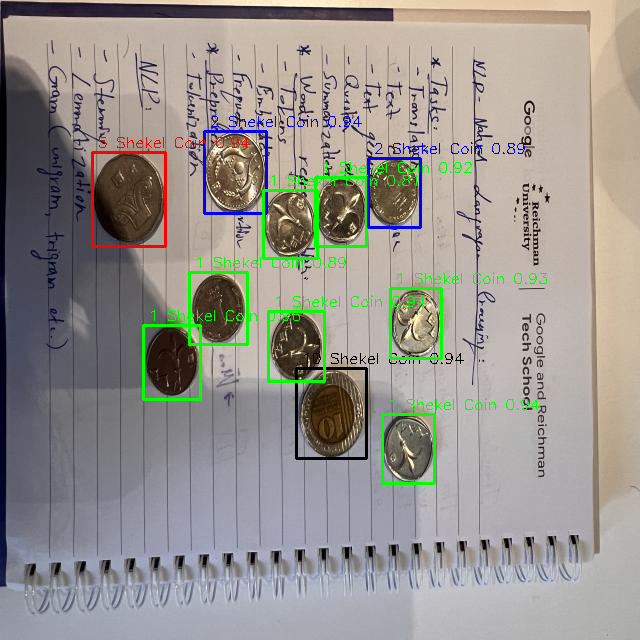



image_true_sums 56
image_pred_sums 77
prediction_accuracy 0.62


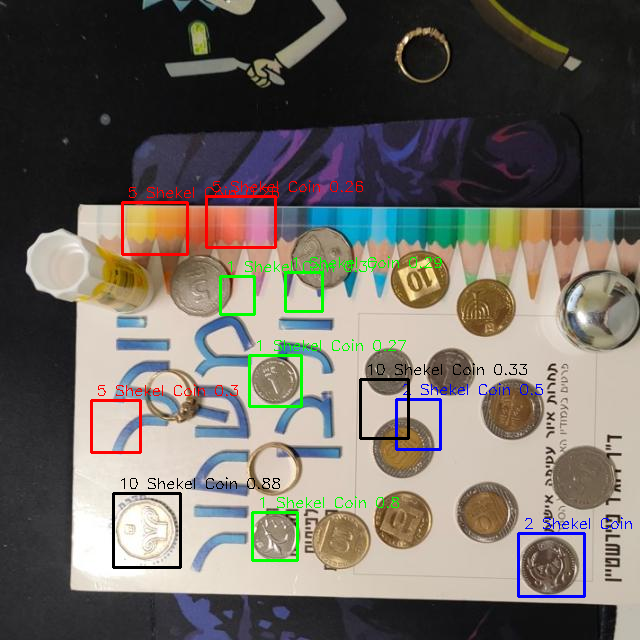



image_true_sums 6
image_pred_sums 6
prediction_accuracy 1.0


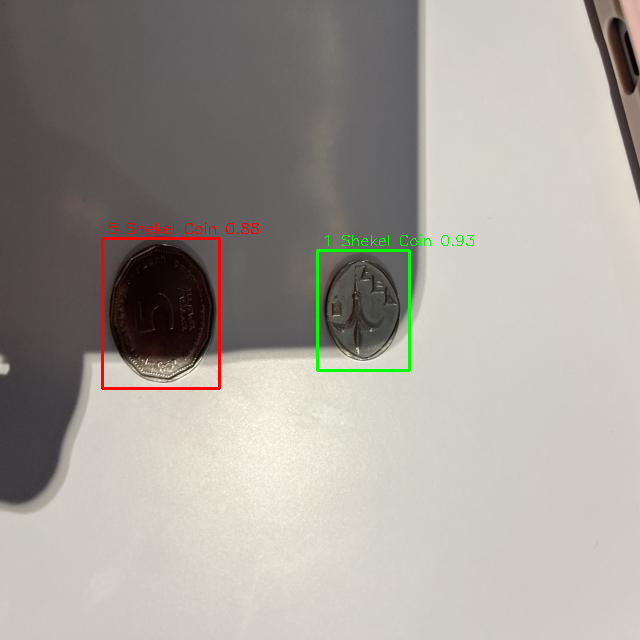

In [32]:
from google.colab.patches import cv2_imshow

# Show test images with bounding box
# Display Inference Images
for id in range(len(os.listdir(os.path.join(base_path, 'images')))):
  print(f'image_true_sums',list(image_true_sums.values())[id])
  print(f'image_pred_sums',list(image_pred_sums.values())[id])
  print(f'prediction_accuracy',list(prediction_accuracy.values())[id])

  s = (os.listdir(os.path.join(base_path, 'images'))[id])
  img = cv2.imread(base_path+'images/'+s)
  model.agnostic = True #we only want one box per item
  results = model(img)

  # Define the dictionary mapping class labels to colors (optional but recommended for clarity)
  class_colors = {0: (0, 255, 0),  # Green for 1 Shekel Coin
                  1: (0, 0, 0),  # Black for 10 Shekel Coin
                  2: (255, 0, 0),  # Red for 2 Shekel Coin
                  3: (0, 0, 255)}  # Blue for 5 Shekel Coin

  for i, row in results.pandas().xyxy[0].iterrows():  # Iterate through rows in the DataFrame
      xmin, ymin, xmax, ymax, confidence, class_label, coin_name = row.values

      # Handle potential issues with NaN values (if applicable)
      if any(np.isnan([xmin, ymin, xmax, ymax])):
          print(f"Warning: Skipping row {i} due to NaN values.")
          continue

      # Extract color based on class label (or use default black)
      color = class_colors.get(class_label, (255, 255, 255))  # white for unknown classes

      # Draw the rectangle
      cv2.rectangle(img, (int(xmin), int(ymin)), (int(xmax), int(ymax)), color, 2)

      # Optionally, add text labels for coin names (modify as needed)
      text_label = results.pandas().xyxy[0].loc[i, 'name']+' '+str(round(results.pandas().xyxy[0].loc[i, 'confidence'],2)) # Access the 'name' column for coin type
      font = cv2.FONT_HERSHEY_SIMPLEX
      text_scale = 0.5
      text_thickness = 1
      (text_width, text_height) = cv2.getTextSize(text_label, font, text_scale, text_thickness)[0]
      text_offset_x = int(xmin) + 5  # Adjust x-offset for better placement
      text_offset_y = int(ymin) - 5  # Adjust y-offset for better placement
      cv2.putText(img, text_label, (text_offset_x, text_offset_y), font, text_scale, color, text_thickness)

  # Display the image with drawn rectangles and text labels (optional)
  cv2_imshow(img)
  print("\n")

In [22]:
print(f"Average Accuracy of Test Images:", round(np.array(list(prediction_accuracy.values())).mean(),2))

Average Accuracy of Test Images: 0.8


In [31]:
# compare time
YOLO_time = end_time_yolo - start_time_yolo
print(f"YOLOv5 time: {YOLO_time} seconds")

YOLOv5 time: 1206.3874733448029 seconds


# Comprehensive Model Comparison:
This section is the heart of the project analysis. It presents a comparison of the performance of VGG16, ResNet50, and YOLOv5 on the coin recognition task. Factors considered in this comparison will include:

* Accuracy: The primary metric of success, measured by the percentage of correctly classified coins across all denominations. This section will compare the accuracy achieved by each model on the test set.
* Speed: Time taken for each model to perform inference on an image. This is crucial for real-world applications where a balance between accuracy and speed is essential.
* Computational Efficiency: The amount of computational resources (e.g., memory, processing power) required by each model for training and inference. This can be estimated by the number of parameters in the model - fewer parameters generally require less computation for both training and inference. This will be particularly relevant if the system is intended to be deployed on resource-constrained devices.

This comprehensive approach not only showcases the development of a coin recognition system but also provides valuable insights into the strengths and weaknesses of different deep learning models for this specific task.

While YOLOv5 has proven to be effective in this project, it's valuable to consider alternative object detection models like ResNet50 and VGG16. Here's a comparative analysis:

Model            | VGG16 | ResNet50 | YOLOv5
 ----------------|-------|----------|-------
 Advantages |Well-established architecture,  | Strong performance on image classification tasks | Real-time inference capability
 |widely used for transfer learning||
 Disadvantages |May not be as efficient as YOLOv5 for object detection,  | Can be computationally expensive for real-time object |May require more training data for
 |especially with smaller datasets|| complex object detection tasks
 Time [Sec] |622 |646 |1206  
 Accuracy |Low | Low | 0.81
 No. #Parameters |27e6|74e6 | 7e6
 Epochs |44|50|100


The choice between these models often hinges on the specific project requirements. If real-time inference is crucial, YOLOv5 excels. For image classification tasks with a large dataset, ResNet50 could be a suitable option. VGG16 is a solid choice for transfer learning scenarios.

## Future Work

Deploy the model: I have used Vertex AI deploying the trained model to a web application or mobile device for real-world coin detection. **I have used Vertex AI to train and deploy a model with reasonable results!**

# Conclusion

This project successfully demonstrated the effectiveness of YOLOv5 for object detection. The trained model achieved promising results in identifying coins within images. The comparison with ResNet50 and VGG16 provided valuable insights into the strengths and trade-offs associated with different models.

